<a href="https://colab.research.google.com/github/lapangos/futech-saw/blob/main/Final_SUmmative_Full_data_Kmeans_Clustering_Customer_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# -*- coding: utf-8 -*-

#import the libraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt #Data Visualization
import seaborn as sns  #Python library for Vidualization

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from termcolor import colored
import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
from sklearn.cluster import KMeans, MiniBatchKMeans, MeanShift, estimate_bandwidth, AffinityPropagation, Birch, DBSCAN, OPTICS, AgglomerativeClustering
from yellowbrick.cluster import KElbowVisualizer
import scipy.cluster.hierarchy as sch
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
from sklearn.model_selection import GridSearchCV
from sklearn import set_config
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.decomposition import PCA
from itertools import product
from sklearn.neighbors import NearestNeighbors
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
try:
    from kneed import KneeLocator
except:
    !pip install kneed
    from kneed import KneeLocator

dataset = pd.read_csv('./Customer_Data.csv')

dataset.head(10) #Printing first 10 rows of the dataset

#total rows and colums in the dataset
dataset.shape

# there are no missing values as all the columns has 200 entries properly
dataset.info()

#Missing values computation
dataset.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   cust_id                           8950 non-null   object 
 1   balance                           8950 non-null   float64
 2   balance_frequency                 8950 non-null   float64
 3   purchases                         8950 non-null   float64
 4   oneoff_purchases                  8950 non-null   float64
 5   installments_purchases            8950 non-null   float64
 6   cash_advance                      8950 non-null   float64
 7   purchases_frequency               8950 non-null   float64
 8   oneoff_purchases_frequency        8950 non-null   float64
 9   purchases_installments_frequency  8950 non-null   float64
 10  cash_advance_frequency            8950 non-null   float64
 11  cash_advance_trx                  8950 non-null   int64  
 12  purcha

cust_id                               0
balance                               0
balance_frequency                     0
purchases                             0
oneoff_purchases                      0
installments_purchases                0
cash_advance                          0
purchases_frequency                   0
oneoff_purchases_frequency            0
purchases_installments_frequency      0
cash_advance_frequency                0
cash_advance_trx                      0
purchases_trx                         0
credit_limit                          1
payments                              0
minimum_payments                    313
prc_full_payment                      0
tenure                                0
dtype: int64

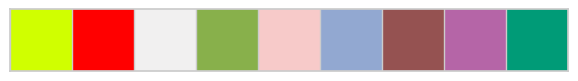

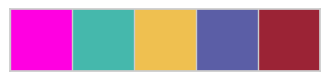

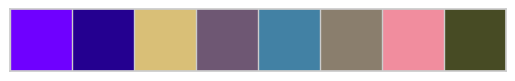

In [ ]:
# Define a custom function to display the color palettes
def custom_palette(custom_colors):
    """Show color palette that use in this notebook"""
    customPalette = sns.set_palette(sns.color_palette(custom_colors))
    sns.palplot(sns.color_palette(custom_colors), size=0.8)
    plt.tick_params(axis='both', labelsize=0, length=0)

# Define the FONT dictionary for plot titles
FONT = {'fontsize': 30, 'fontstyle': 'normal', 'fontfamily': 'DejaVu Sans', 'backgroundcolor': '#B41B10', 'color': '#E4C09E'}

# Create List of Color Palettes with premium and pastel colors
colors1 = ["#d0ff00", "#ff0000", "#F1F0F0", "#88B04B", "#F7CAC9", "#92A8D1", "#955251", "#B565A7", "#009B77"]
colors2 = ["#ff00e1", "#45B8AC", "#EFC050", "#5B5EA6", "#9B2335"]
dark_colors = ["#6f00ff","#240090", "#D9BF77", "#6E5773", "#4281A4", "#8A7E6D", "#F18D9E", "#474B24"]

# Plot Color Palettes
for color in [colors1, colors2, dark_colors]:
    custom_palette(color)

In [ ]:
# Import customer dataset
dataset = pd.read_csv("./Customer_Data.csv")
dataset

,cust_id,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [ ]:
# Overview of dataset
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   cust_id                           8950 non-null   object 
 1   balance                           8950 non-null   float64
 2   balance_frequency                 8950 non-null   float64
 3   purchases                         8950 non-null   float64
 4   oneoff_purchases                  8950 non-null   float64
 5   installments_purchases            8950 non-null   float64
 6   cash_advance                      8950 non-null   float64
 7   purchases_frequency               8950 non-null   float64
 8   oneoff_purchases_frequency        8950 non-null   float64
 9   purchases_installments_frequency  8950 non-null   float64
 10  cash_advance_frequency            8950 non-null   float64
 11  cash_advance_trx                  8950 non-null   int64  
 12  purcha

In [ ]:
# Drop the cust_id columns because we do not neet it
dataset = dataset.drop('cust_id', axis=1)

In [ ]:
def highlight_cells(val):
    """Highlight cells that is not zero"""
    f_color = '#FFFF00' if val != 0 else ''  # Yellow
    bg_color = '#8F00FF' if val != 0 else ''   # Violet
    w_font = 'bold'
    return 'background-color: {}; color: {}; font-weight: {}'.format(bg_color, f_color, w_font)

# Check missing values
is_nan = dataset.isna().sum().to_frame(name='Number_of_NaN')
is_nan.insert(1,'Percent(%)', [round(x/dataset.shape[0]*100,2) for x in is_nan.Number_of_NaN])
is_nan.style.applymap(highlight_cells)

,Number_of_NaN,Percent(%)
balance,0,0.000000
balance_frequency,0,0.000000
purchases,0,0.000000
oneoff_purchases,0,0.000000
installments_purchases,0,0.000000
cash_advance,0,0.000000
purchases_frequency,0,0.000000
oneoff_purchases_frequency,0,0.000000
purchases_installments_frequency,0,0.000000
cash_advance_frequency,0,0.000000


In [ ]:
# Overview nan value in credit_limit column
dataset[dataset.credit_limit.isna()]

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
5203,18.400472,0.166667,0.0,0.0,0.0,186.853063,0.0,0.0,0.0,0.166667,1,0,NaN,9.040017,14.418723,0.0,6


In [ ]:
# Drop row with nan value in credit_limit
dataset = dataset.drop(dataset[dataset.credit_limit.isna()].index, axis=0)

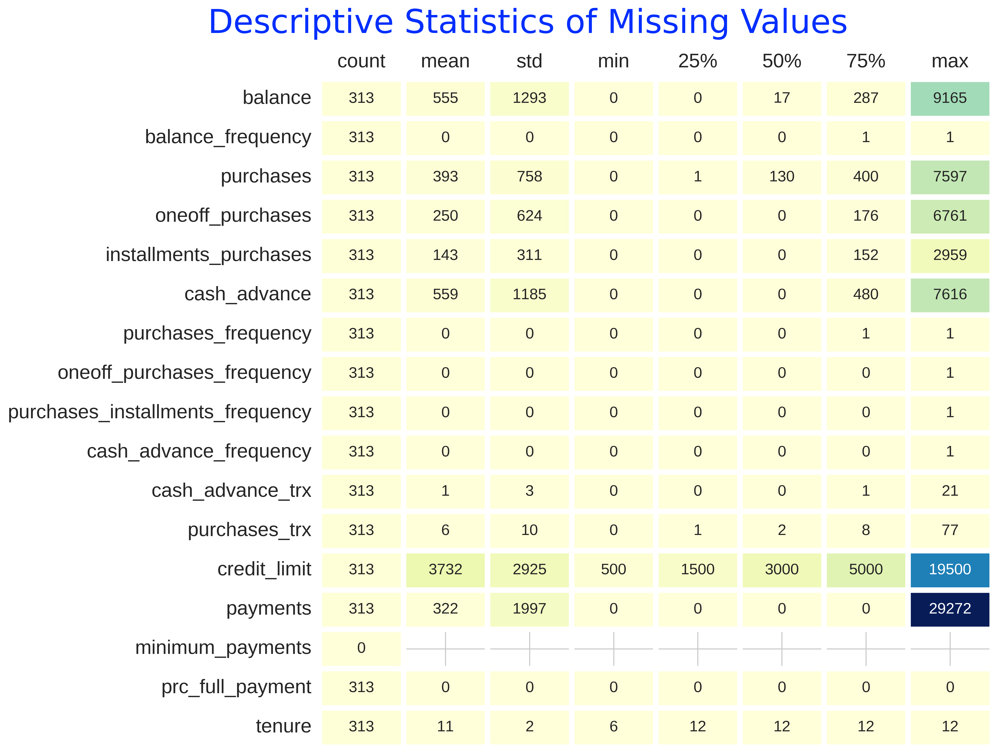

In [ ]:
# Define the FONT dictionary for plot titles with a new purple background color
FONT = {'fontsize': 30, 'fontstyle': 'normal', 'fontfamily': 'DejaVu Sans', 'backgroundcolor': '#FFFFFF', 'color': '#002EFF'}

# Show details of data points with missing values
desc_cust = dataset[dataset.minimum_payments.isna()].describe().T
desc_cust_dataset = pd.DataFrame(index=desc_cust.index, columns=desc_cust.columns, data=desc_cust)

f, ax = plt.subplots(figsize=(11, 11), dpi=500)

sns.heatmap(desc_cust_dataset, annot=True, cmap="YlGnBu", fmt='.0f', ax=ax, linewidths=5, cbar=False, annot_kws={"size": 14})

ax.xaxis.set_ticks_position('top')
plt.tick_params(left=False, top=False)
plt.xticks(size=18)
plt.yticks(size=18)

plt.title("Descriptive Statistics of Missing Values", pad=30, x=0.31, y=1.02, fontdict=FONT)
plt.show()

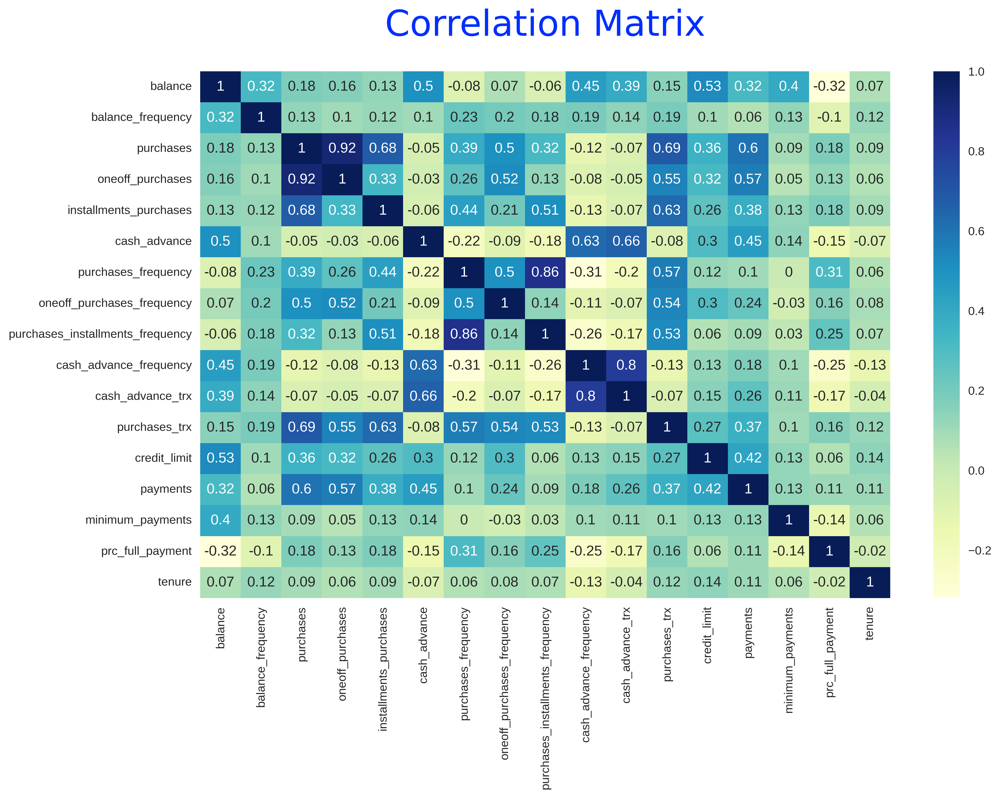

In [ ]:
# Overview correlation between features
plt.figure(figsize=(13,8), dpi=500)
sns.heatmap(round(dataset.corr(),2), annot=True, cmap='YlGnBu')
plt.title("Correlation Matrix", pad=30, fontdict=FONT)
plt.show()

In [ ]:
# Fill the remaining missing values with KNNimputer()
# Define imputer
imputer = KNNImputer()
# Fit on the dataset
imputer.fit(dataset)
# Transform the dataset
dataset1 = pd.DataFrame(imputer.transform(dataset),columns=dataset.columns)

# Print result
print(colored(f'Missing (before): {dataset.isna().sum().sum()}', 'red'))
print(colored(f'Missing (after): {dataset1.isna().sum().sum()}', 'green'))

Missing (before): 313
Missing (after): 0


In [ ]:
# Check duplicated data
print(colored(f"Number of dupilcated data: {dataset1.duplicated().sum()}", 'red'), )

Number of dupilcated data: 0


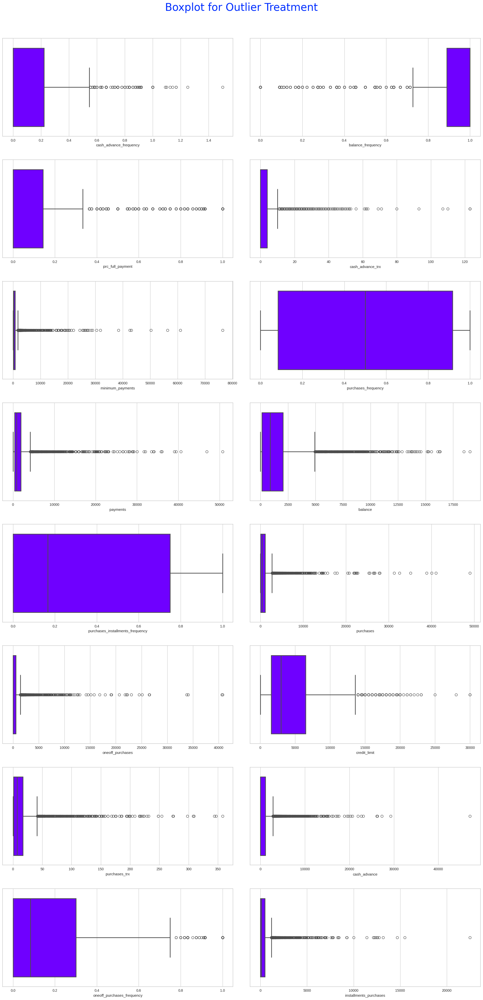

In [ ]:
# Draw pair plot for check noise and
# pplot = sns.pairplot(dataset1, palette="#B41B10")
# pplot.fig.suptitle("Pariplot of Features", y=1.02, **FONT)
# pplot.tight_layout()
# plt.show()

# Draw boxplot for check outliers
fig ,ax = plt.subplots(8,2,figsize=(20,40))
for i, col in enumerate(set(dataset1.columns)-set(['tenure'])):
    sns.boxplot(data=dataset1, x=col, palette=dark_colors, saturation=1, linewidth = 2, ax=ax[i//2, i%2])
plt.suptitle("Boxplot for Outlier Treatment", y=1, **FONT)
plt.tight_layout(pad=3.0)
plt.show()

In [ ]:
from sklearn.preprocessing import PowerTransformer

In [ ]:
PT = PowerTransformer()

print(PT.fit_transform(dataset))

[[-1.23833786 -1.0801604  -0.36831098 ... -0.81526922 -0.67793662
   0.42210751]
 [ 1.05188287 -0.4256199  -1.50536123 ...  0.89703093  1.23484635
   0.42210751]
 [ 0.86050618  0.62852726  0.52149237 ...  0.462236   -0.67793662
   0.42210751]
 ...
 [-1.40957025 -0.9921333  -0.21655169 ... -1.28218108  1.32828513
  -2.52719186]
 [-1.55874115 -0.9921333  -1.50536123 ... -1.63468322  1.32828513
  -2.52719186]
 [-0.32454944 -1.6469605   0.70189133 ... -1.22061016 -0.67793662
  -2.52719186]]


In [ ]:
dataset.shape

(8949, 17)

In [ ]:
print(dataset.columns)

Index(['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
       'installments_purchases', 'cash_advance', 'purchases_frequency',
       'oneoff_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
       'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
       'tenure'],
      dtype='object')


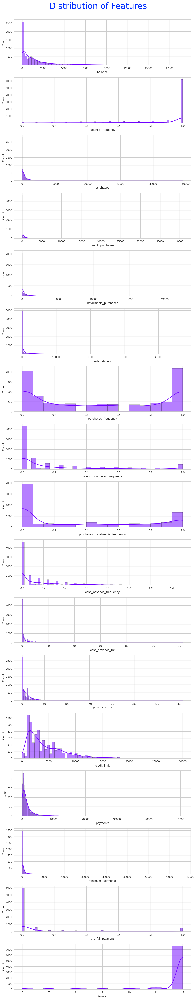

In [ ]:
# Check distribution of features
fig, ax = plt.subplots(17, 1, figsize=(10,50))
for i, col in enumerate(dataset1):
    sns.histplot(dataset1[col], kde=True, ax=ax[i], palette=colors2)

fig.suptitle('Distribution of Features',y=1.002, **FONT)
fig.tight_layout()
plt.show()

In [ ]:
# KPIs

# Check if the dataset contains all required columns (lowercase names)
required_columns = ['purchases', 'cash_advance', 'tenure', 'credit_limit', 'balance', 'payments', 'minimum_payments']
for col in required_columns:
    if col not in dataset.columns:
        raise ValueError(f"Column '{col}' not found in dataset")

# 1. Monthly Average Purchase
dataset['Monthly_Avg_Purchase'] = dataset['purchases'] / dataset['tenure']

# 2. Credit Utilization Ratio
dataset['Credit_Utilization_Ratio'] = (dataset['purchases'] + dataset['cash_advance']) / dataset['credit_limit']

# 3. Limit Usage (Balance to Credit Limit Ratio)
dataset['Limit_Usage'] = dataset['balance'] / dataset['credit_limit']

# 4. Payments to Minimum Payments Ratio
dataset['Pay_to_MinimumPay'] = dataset['payments'] / dataset['minimum_payments']

# 5. Purchase Type Category
dataset['Purchase_Type'] = np.where((dataset['oneoff_purchases'] == 0) & (dataset['installments_purchases'] == 0),
                                    'None_Of_the_Purchases',
                                    np.where((dataset['oneoff_purchases'] > 0) & (dataset['installments_purchases'] == 0),
                                             'One_Off_Purchase',
                                             np.where((dataset['oneoff_purchases'] == 0) & (dataset['installments_purchases'] > 0),
                                                      'Installment_Purchases',
                                                      'Both_Purchases')))

# Display the dataset with new KPIs
print(dataset[['Monthly_Avg_Purchase', 'Credit_Utilization_Ratio', 'Limit_Usage', 'Pay_to_MinimumPay', 'Purchase_Type']].head())



   Monthly_Avg_Purchase  Credit_Utilization_Ratio  Limit_Usage  \
0              7.950000                  0.095400     0.040901   
1              0.000000                  0.920421     0.457495   
2             64.430833                  0.103089     0.332687   
3            124.916667                  0.227305     0.222223   
4              1.333333                  0.013333     0.681429   

   Pay_to_MinimumPay          Purchase_Type  
0           1.446508  Installment_Purchases  
1           3.826241  None_Of_the_Purchases  
2           0.991682       One_Off_Purchase  
3                NaN       One_Off_Purchase  
4           2.771075       One_Off_Purchase  


In [ ]:
# Purchase Type Categories are as follows:
dataset['Purchase_Type'] .value_counts()

Purchase_Type
Both_Purchases           2774
Installment_Purchases    2260
None_Of_the_Purchases    2041
One_Off_Purchase         1874
Name: count, dtype: int64

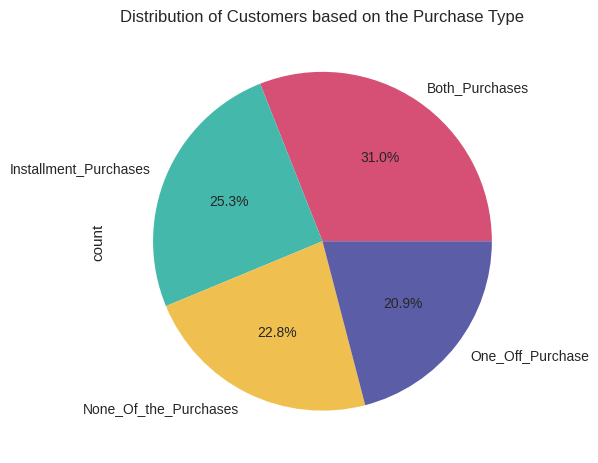

In [ ]:
# Plotting the distribution of customer on basis of Purhcase Type
dataset['Purchase_Type'].value_counts().sort_index().plot(kind='pie',autopct='%1.01f%%',
                     colors =['#D65076', '#45B8AC', '#EFC050', '#5B5EA6'],fontsize=10,textprops = {'fontsize': 18})
plt.title('Distribution of Customers based on the Purchase Type')
plt.show()

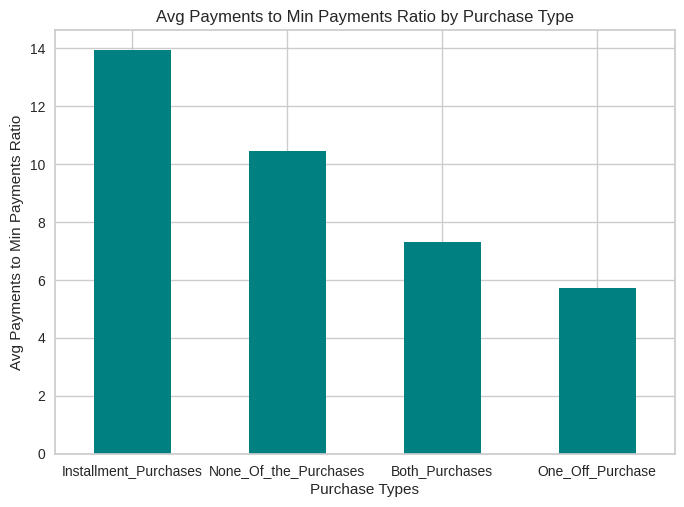

In [ ]:
# Step 1: Calculate the average Pay_to_MinimumPay for each Purchase Type
pay_min_pay_avg = dataset.groupby('Purchase_Type')['Pay_to_MinimumPay'].mean().sort_values(ascending=False)

# Step 2: Plot the results
pay_min_pay_avg.plot(kind='bar', color='teal')
plt.title('Avg Payments to Min Payments Ratio by Purchase Type')
plt.xlabel('Purchase Types')
plt.ylabel('Avg Payments to Min Payments Ratio')
plt.xticks(rotation=0)
plt.show()

# Insight:
# Customers making installment purchases have the highest average payments to minimum payments ratio.


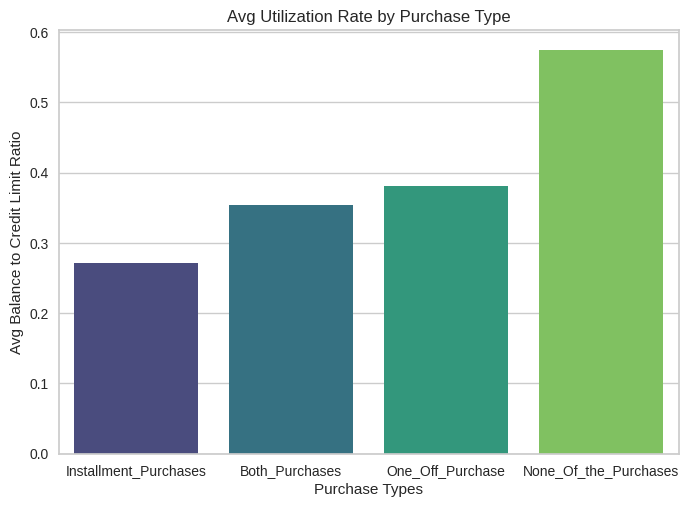

In [ ]:
# Step 1: Calculate the average Limit Usage for each Purchase Type
limit_usage_avg = dataset.groupby('Purchase_Type')['Limit_Usage'].mean().sort_values(ascending=True).reset_index()

# Step 2: Plot the results
sns.barplot(data=limit_usage_avg, x='Purchase_Type', y='Limit_Usage', palette='viridis')
plt.title('Avg Utilization Rate by Purchase Type')
plt.xlabel('Purchase Types')
plt.ylabel('Avg Balance to Credit Limit Ratio')
plt.show()

# Insight:
# Customers who favor installment purchases show the lowest credit utilization rate, indicating better credit management.


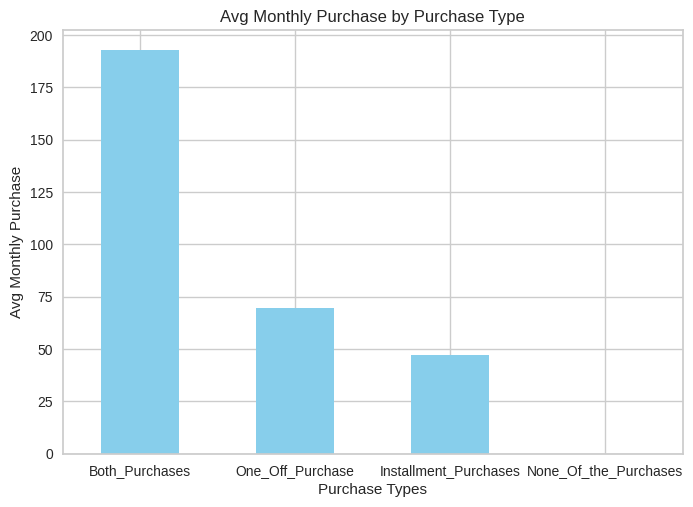

In [ ]:
# Step 1: Calculate the average Monthly_Avg_Purchase for each Purchase Type
monthly_avg_purchase_avg = dataset.groupby('Purchase_Type')['Monthly_Avg_Purchase'].mean().sort_values(ascending=False)

# Step 2: Plot the results
monthly_avg_purchase_avg.plot(kind='bar', color='skyblue')
plt.title('Avg Monthly Purchase by Purchase Type')
plt.xlabel('Purchase Types')
plt.ylabel('Avg Monthly Purchase')
plt.xticks(rotation=0)
plt.show()

# Insight:
# Customers who engage in both one-off and installment purchases have the highest average monthly purchase amounts.


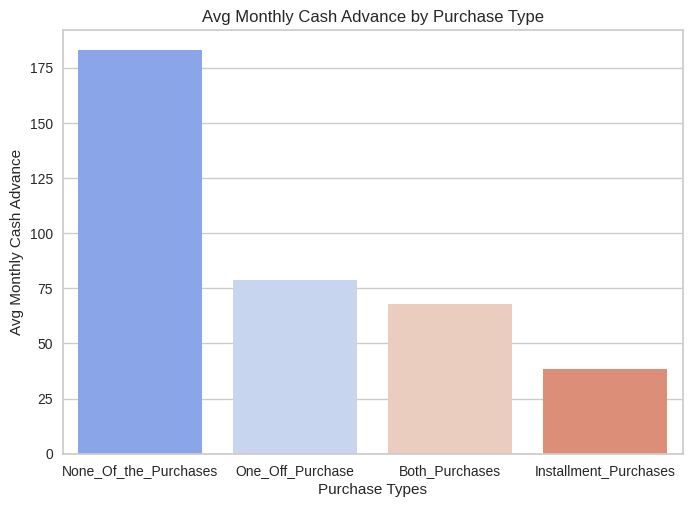

In [ ]:
# Step 1: Calculate the average Monthly_Avg_Cash for each Purchase Type

dataset['Monthly_Avg_Cash'] = dataset['cash_advance'] / dataset['tenure']

monthly_avg_cash_avg = dataset.groupby('Purchase_Type')['Monthly_Avg_Cash'].mean().sort_values(ascending=False).reset_index()

# Step 2: Plot the results
sns.barplot(data=monthly_avg_cash_avg, x='Purchase_Type', y='Monthly_Avg_Cash', palette='coolwarm')
plt.title('Avg Monthly Cash Advance by Purchase Type')
plt.xlabel('Purchase Types')
plt.ylabel('Avg Monthly Cash Advance')
plt.show()

# Insight:
# Customers who neither make one-off purchases nor installment purchases tend to have the highest monthly cash advance amounts.


In [ ]:
# Correlation Matrix

# Display column names to verify
print(dataset.columns)

Index(['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
       'installments_purchases', 'cash_advance', 'purchases_frequency',
       'oneoff_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
       'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
       'tenure', 'Monthly_Avg_Purchase', 'Credit_Utilization_Ratio',
       'Limit_Usage', 'Pay_to_MinimumPay', 'Purchase_Type',
       'Monthly_Avg_Cash'],
      dtype='object')


In [ ]:
# Dropping the original variables and the Purchase_Type column
columns_to_drop = ['balance', 'credit_limit', 'purchases', 'payments', 'minimum_payments', 'tenure', 'cash_advance', 'Purchase_Type']
columns_to_drop = [col for col in columns_to_drop if col in dataset.columns]  # Ensure only existing columns are dropped

dataset_reduced = dataset.drop(columns=columns_to_drop, axis=1)

# Calculate the correlation matrix
corr_matrix = dataset_reduced.corr()

# Display column names to verify
print(dataset.columns)

Index(['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
       'installments_purchases', 'cash_advance', 'purchases_frequency',
       'oneoff_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
       'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
       'tenure', 'Monthly_Avg_Purchase', 'Credit_Utilization_Ratio',
       'Limit_Usage', 'Pay_to_MinimumPay', 'Purchase_Type',
       'Monthly_Avg_Cash'],
      dtype='object')


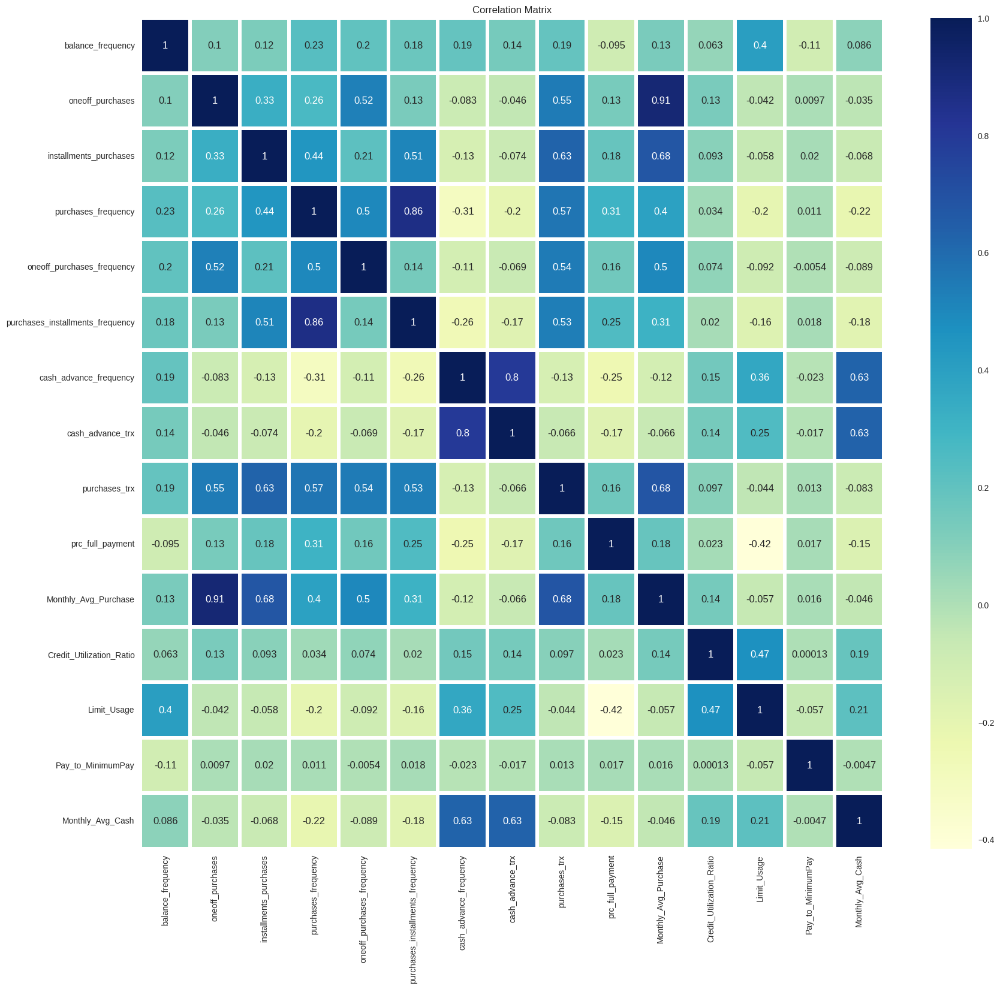

In [ ]:
# Plotting the correlation matrix
plt.figure(figsize=(20,18))
sns.heatmap(corr_matrix, annot=True, cmap='YlGnBu', linewidths=3, fmt='.2g')
plt.title('Correlation Matrix')
plt.show()

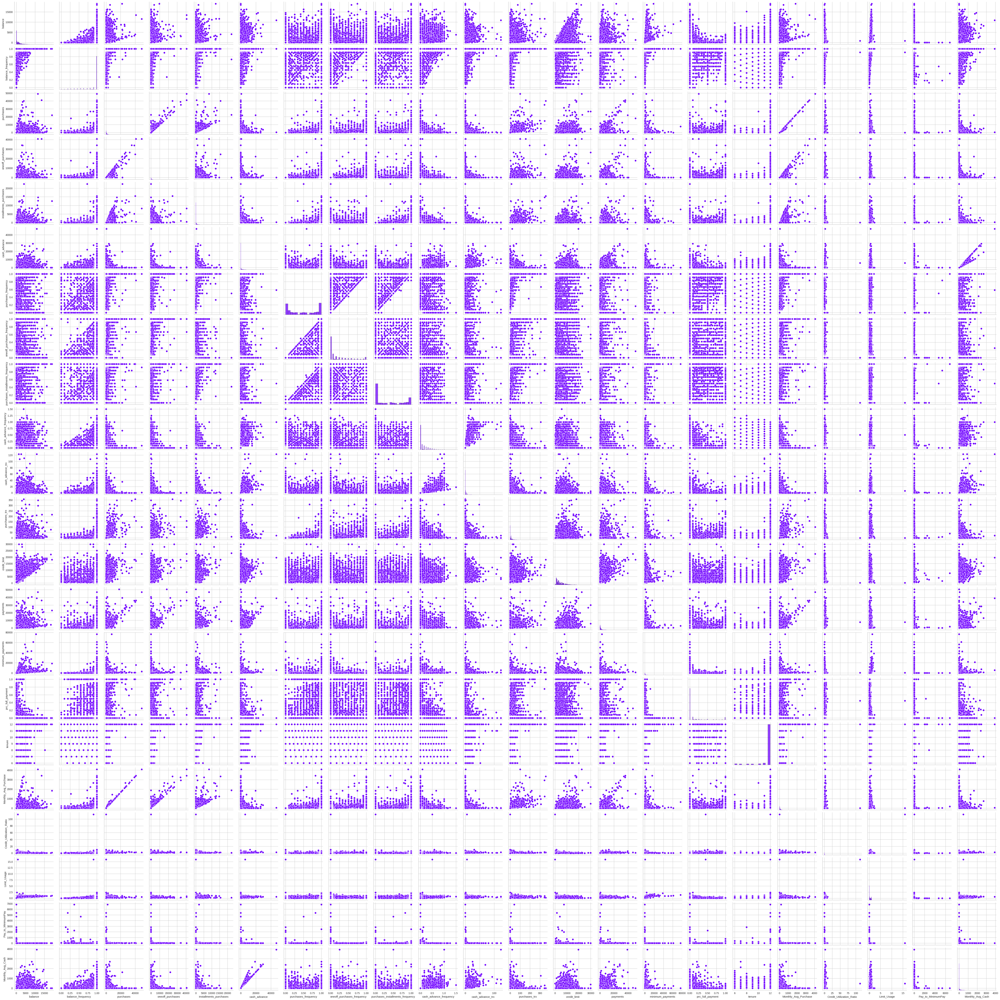

In [ ]:
# Plotting Pair Plot
sns.pairplot(dataset)
plt.show()

  Installment_Purchases None_Of_the_Purchases One_Off_Purchase   balance  \
0                  True                 False            False -0.732054   
1                 False                  True            False  0.786858   
2                 False                 False             True  0.447041   
3                 False                 False             True  0.049015   
4                 False                 False             True -0.358849   

   balance_frequency  purchases  oneoff_purchases  installments_purchases  \
0          -0.249881  -0.424934         -0.356957               -0.349114   
1           0.134049  -0.469584         -0.356957               -0.454607   
2           0.517980  -0.107716          0.108843               -0.454607   
3          -1.017743   0.231995          0.546123               -0.454607   
4           0.517980  -0.462095         -0.347317               -0.454607   

   cash_advance  purchases_frequency  ...  credit_limit  payments  \
0     -0.46

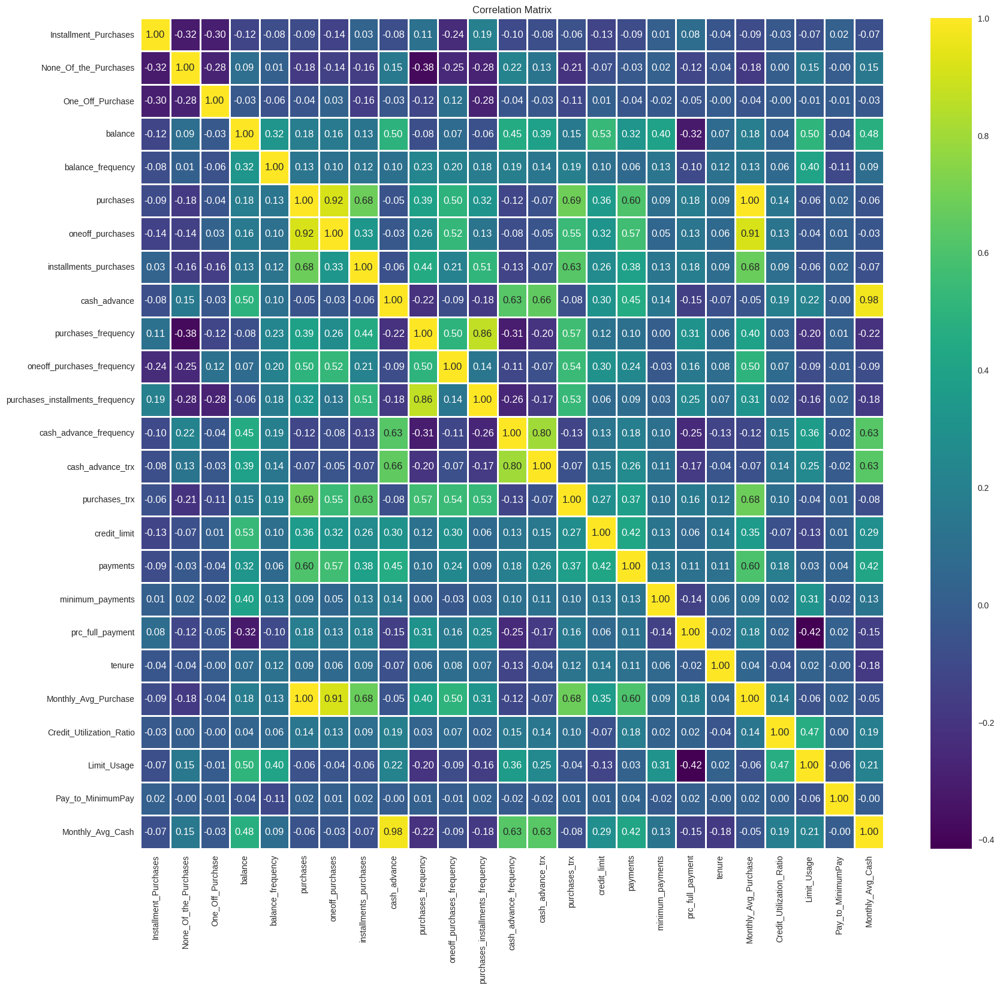

In [ ]:
# Data Modeling
# Create dummy variables for Purchase_Type
categorical_features = pd.get_dummies(dataset['Purchase_Type'], drop_first=True)

# Select numerical variables
numerical_features = dataset.select_dtypes(include=[np.number]).columns.tolist()

# Scale the numerical variables
scaler = StandardScaler()
scaled_numerical_features = pd.DataFrame(scaler.fit_transform(dataset[numerical_features]), columns=numerical_features)

# Combine the categorical and scaled numerical datasets
prepared_dataset = pd.concat([categorical_features, scaled_numerical_features], axis=1)

# Display the head of the combined dataset
print(prepared_dataset.head())

# Plotting the correlation matrix
plt.figure(figsize=(20,18))
sns.heatmap(prepared_dataset.corr(), annot=True, cmap='viridis', linewidths=2, fmt='.2f')
plt.title('Correlation Matrix')
plt.show()


In [ ]:
# Fill missing values with the mean of each column
prepared_dataset = prepared_dataset.fillna(prepared_dataset.mean())

# Verify that there are no more missing values
print(prepared_dataset.isna().sum())

# Assuming `prepared_dataset` is the dataset we have after combining dummy variables and scaling numerical features
scaler = StandardScaler()
scaled_data = scaler.fit_transform(prepared_dataset)

# Display the first few rows of the scaled data to verify
print(pd.DataFrame(scaled_data, columns=prepared_dataset.columns).head())



Installment_Purchases               0
None_Of_the_Purchases               0
One_Off_Purchase                    0
balance                             0
balance_frequency                   0
purchases                           0
oneoff_purchases                    0
installments_purchases              0
cash_advance                        0
purchases_frequency                 0
oneoff_purchases_frequency          0
purchases_installments_frequency    0
cash_advance_frequency              0
cash_advance_trx                    0
purchases_trx                       0
credit_limit                        0
payments                            0
minimum_payments                    0
prc_full_payment                    0
tenure                              0
Monthly_Avg_Purchase                0
Credit_Utilization_Ratio            0
Limit_Usage                         0
Pay_to_MinimumPay                   0
Monthly_Avg_Cash                    0
dtype: int64
   Installment_Purchases  None_Of_the

In [ ]:
# Calculating the covariance matrix
cov_matrix = np.cov(scaled_data.T)
print('Shape of Covariance Matrix:', cov_matrix.shape)
print('Covariance Matrix:\n', cov_matrix)


Shape of Covariance Matrix: (25, 25)
Covariance Matrix:
 [[ 1.00011174e+00 -3.15985742e-01 -2.99187690e-01 -1.23341996e-01
  -7.83762187e-02 -9.36957219e-02 -1.38679974e-01  3.33668333e-02
  -7.58944220e-02  1.12062345e-01 -2.38984868e-01  1.94970157e-01
  -9.81009611e-02 -7.73690633e-02 -5.96740961e-02 -1.33174346e-01
  -9.16055940e-02  5.88379992e-03  8.30050936e-02 -3.83630205e-02
  -9.23330313e-02 -2.72820740e-02 -7.45481321e-02  1.59357050e-02
  -7.21194732e-02]
 [-3.15985742e-01  1.00011174e+00 -2.79779208e-01  9.23416215e-02
   1.09351200e-02 -1.77816242e-01 -1.39501479e-01 -1.64053483e-01
   1.54230559e-01 -3.82466112e-01 -2.50914116e-01 -2.77947687e-01
   2.15148092e-01  1.29252155e-01 -2.07375922e-01 -6.82301448e-02
  -2.71885400e-02  1.96623471e-02 -1.21326123e-01 -4.36249616e-02
  -1.79151217e-01  2.94169742e-03  1.52149822e-01 -4.30488903e-03
   1.53303175e-01]
 [-2.99187690e-01 -2.79779208e-01  1.00011174e+00 -2.76998960e-02
  -5.67290414e-02 -4.29712902e-02  2.97268987e-

In [ ]:
# Calculating eigenvalues and eigenvectors
eig_val, eig_vec = np.linalg.eig(cov_matrix)
print('Number of Eigenvalues:', len(eig_val))
print('Shape of Eigenvectors:', eig_vec.shape)
print('Eigenvalues:\n', eig_val)
print('Eigenvectors:\n', eig_vec)


Number of Eigenvalues: 25
Shape of Eigenvectors: (25, 25)
Eigenvalues:
 [5.58191917e+00 4.47760281e+00 1.88354343e+00 1.75443482e+00
 1.36623708e+00 1.32430870e+00 1.16588489e+00 9.97088404e-01
 9.51569676e-01 8.73119104e-01 7.43062430e-01 6.96678461e-01
 6.45252439e-01 5.71460876e-01 4.18137810e-01 3.45902981e-01
 3.12673833e-01 2.81531928e-01 2.52264717e-01 1.74072609e-01
 1.23649016e-01 4.19003050e-02 1.60839625e-02 4.40252769e-03
 1.16325977e-05]
Eigenvectors:
 [[-1.88545245e-02  1.01792460e-01  3.53401402e-01 -2.65744713e-01
   6.85748608e-02 -4.88788605e-02 -4.85460710e-01  1.55445424e-01
   1.39628809e-01 -3.78234518e-01 -2.38573697e-01  6.61542036e-02
  -1.14194356e-02 -3.53944166e-02 -1.42918069e-01  1.45628298e-01
   4.55898741e-01 -1.90064126e-01  1.14090464e-01  2.29121388e-02
   1.86665205e-02  4.60012413e-02 -9.87931728e-04 -3.29943132e-04
   7.53345892e-05]
 [-1.35025623e-01 -1.15966647e-01 -8.02939087e-02  7.75317532e-02
   2.97091374e-01 -4.36659576e-01  5.00727105e-01

In [ ]:
# Pairing eigenvalues with eigenvectors
eigen_pairs = [(eig_val[i], eig_vec[:,i]) for i in range(len(eig_val))]
eigen_pairs_sorted = sorted(eigen_pairs, key=lambda x: x[0], reverse=True)

# Extracting sorted eigenvalues and eigenvectors
eig_val_sorted = [eigen_pairs_sorted[i][0] for i in range(len(eig_val))]
eig_vec_sorted = [eigen_pairs_sorted[i][1] for i in range(len(eig_val))]

# Displaying sorted eigenvalues
print('Sorted Eigenvalues:', eig_val_sorted)


Sorted Eigenvalues: [5.581919169593167, 4.477602813706266, 1.8835434257128085, 1.7544348237976444, 1.366237076215946, 1.3243086956726584, 1.165884891731997, 0.9970884044016911, 0.9515696764851725, 0.8731191038537519, 0.7430624295415349, 0.6966784605084685, 0.645252439324705, 0.5714608756873141, 0.4181378101494169, 0.34590298088215965, 0.3126738334880857, 0.2815319276321111, 0.25226471716129734, 0.17407260897754054, 0.12364901597931176, 0.04190030498639806, 0.016083962451638772, 0.004402527685662063, 1.1632597671536116e-05]


Cumulative Variance Explained: [ 22.32518197  40.23359206  47.76692395  54.78387914  60.24821684
  65.54485975  70.20787825  74.19578624  78.00163967  81.49372586
  84.46564349  87.25204596  89.83276734  92.11835544  93.7907198
  95.17417713  96.42473273  97.55073461  98.55968074  99.25589337
  99.75043418  99.91801667  99.98234533  99.99995347 100.        ]


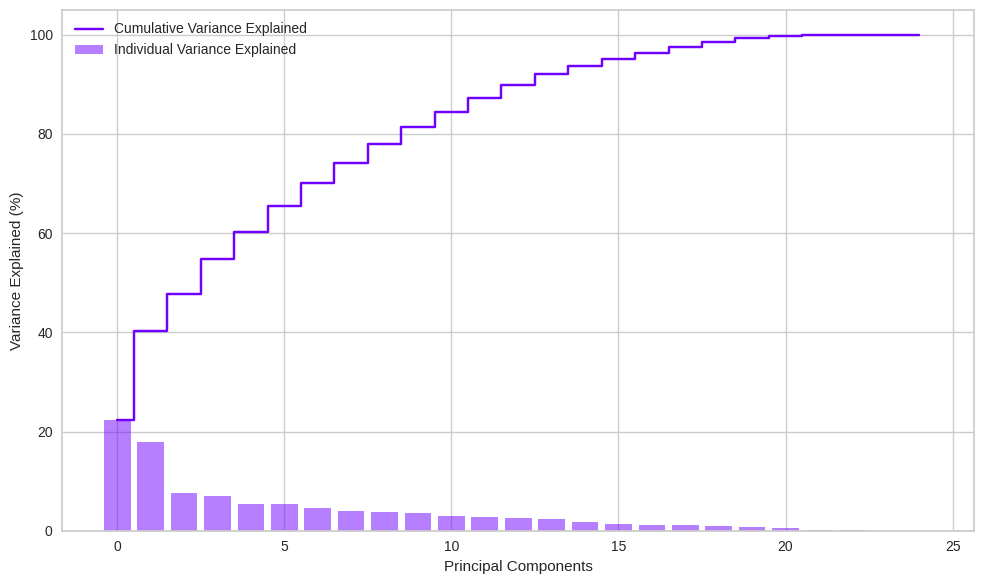

In [ ]:
# Calculating explained variance
total_variance = np.sum(eig_val)
explained_variance = [(i/total_variance) * 100 for i in eig_val_sorted]
cumulative_variance = np.cumsum(explained_variance)

print('Cumulative Variance Explained:', cumulative_variance)

# Plotting the explained variance
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.bar(range(len(explained_variance)), explained_variance, alpha=0.5, align='center', label='Individual Variance Explained')
plt.step(range(len(cumulative_variance)), cumulative_variance, where='mid', label='Cumulative Variance Explained')
plt.xlabel('Principal Components')
plt.ylabel('Variance Explained (%)')
plt.legend(loc='best')
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.decomposition import PCA

# Applying PCA
pca_model = PCA(n_components=17)  # Start with all components
pca_data = pca_model.fit_transform(scaled_data)

# Checking the shape of the PCA transformed data
print('Shape of PCA Data:', pca_data.shape)

# Cumulative variance explained by the PCA components
cumulative_variance_sklearn = np.cumsum(pca_model.explained_variance_ratio_ * 100)
print('Cumulative Variance Explained (sklearn):', cumulative_variance_sklearn)


Shape of PCA Data: (8950, 17)
Cumulative Variance Explained (sklearn): [22.32518197 40.23359206 47.76692395 54.78387914 60.24821684 65.54485975
 70.20787825 74.19578624 78.00163967 81.49372586 84.46564349 87.25204596
 89.83276734 92.11835544 93.7907198  95.17417713 96.42473273]


In [ ]:
# Choosing 7 components to explain around 85% of the variance
pca_model_7 = PCA(n_components=7)
pca_data_7 = pca_model_7.fit_transform(scaled_data)

# Creating a DataFrame for the 7 principal components
principal_components_df = pd.DataFrame(data=pca_data_7, columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7'])
print(principal_components_df.head())


        PC1       PC2       PC3       PC4       PC5       PC6       PC7
0 -1.491047 -1.735931  0.198349 -0.417853  0.281674 -0.551636  1.200690
1 -1.681891  3.333998 -0.646026 -1.109394  0.271567 -1.079268 -0.837768
2  0.864777 -0.587862 -1.346529  1.617340 -2.264929  1.624998 -0.316576
3 -0.594057 -0.373111 -2.311467  0.774321 -0.874506  0.090165  1.262935
4 -1.594493 -0.794978 -1.059536  1.796223 -0.467301  0.855967  0.655905


In [ ]:
# List of original features
original_features = prepared_dataset.columns

# Creating the loadings matrix
loadings_matrix = pd.DataFrame(pca_model_7.components_.T, columns=['PC'+str(i+1) for i in range(7)], index=original_features)

print(loadings_matrix)

# Exporting the loadings matrix to CSV
loadings_matrix.to_csv('loadings_matrix.csv')

                                       PC1       PC2       PC3       PC4  \
Installment_Purchases            -0.018854 -0.101792  0.352960 -0.265752   
None_Of_the_Purchases            -0.135025  0.115968 -0.080866  0.077529   
One_Off_Purchase                 -0.032152 -0.007618 -0.359430  0.195992   
balance                           0.062844  0.350748  0.108951  0.172693   
balance_frequency                 0.086618  0.132744  0.294998  0.306084   
purchases                         0.387953  0.063088 -0.145484  0.048657   
oneoff_purchases                  0.332047  0.075462 -0.272032  0.091802   
installments_purchases            0.307192  0.010471  0.155709 -0.053634   
cash_advance                     -0.048420  0.399297  0.014749 -0.282256   
purchases_frequency               0.284789 -0.137187  0.316217 -0.091337   
oneoff_purchases_frequency        0.265658  0.003015 -0.157235  0.123110   
purchases_installments_frequency  0.240285 -0.126920  0.443874 -0.157499   
cash_advance

In [ ]:
from scipy.cluster.hierarchy import linkage, cophenet
from scipy.spatial.distance import pdist

# Finding the Cophenetic Distance Correlation Coefficient for different Linkages
linkage_methods = ['single', 'complete', 'average', 'ward']
distance_metrics = ['euclidean', 'cityblock', 'cosine']

for method in linkage_methods:
    print(f'Linkage: {method}')
    for metric in distance_metrics:
        if method == 'ward' and metric != 'euclidean':
            continue  # Ward linkage only works with Euclidean distance
        Z = linkage(pca_data, method=method, metric=metric)
        c, coph_dist = cophenet(Z, pdist(pca_data))
        print(f'Cophenetic Distance Correlation Coefficient for {metric} distance: {c:.4f}')
    print()


Linkage: single
Cophenetic Distance Correlation Coefficient for euclidean distance: 0.7661
Cophenetic Distance Correlation Coefficient for cityblock distance: 0.7297
Cophenetic Distance Correlation Coefficient for cosine distance: 0.1087

Linkage: complete
Cophenetic Distance Correlation Coefficient for euclidean distance: 0.6741
Cophenetic Distance Correlation Coefficient for cityblock distance: 0.7133
Cophenetic Distance Correlation Coefficient for cosine distance: 0.1683

Linkage: average
Cophenetic Distance Correlation Coefficient for euclidean distance: 0.8971
Cophenetic Distance Correlation Coefficient for cityblock distance: 0.8839
Cophenetic Distance Correlation Coefficient for cosine distance: 0.2027

Linkage: ward
Cophenetic Distance Correlation Coefficient for euclidean distance: 0.3434



In [ ]:
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Initialize lists to store the results
wcss = []
sil_kmeans = []
sil_agc = []

# Apply clustering for 3 to 6 clusters
for n_clusters in range(3, 7):
    # KMeans Clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    kmeans_labels = kmeans.fit_predict(pca_data)

    # Inertia and Silhouette Score for KMeans
    wcss.append(kmeans.inertia_)
    sil_kmeans.append(silhouette_score(pca_data, kmeans_labels))

    # Agglomerative Clustering
    agc = AgglomerativeClustering(n_clusters=n_clusters, affinity='cityblock', linkage='average')
    agc_labels = agc.fit_predict(pca_data)
    sil_agc.append(silhouette_score(pca_data, agc_labels))

    # Print results for each cluster number
    print(f'Number of clusters: {n_clusters}')
    print(f'KMeans Inertia: {kmeans.inertia_:.2f}')
    print(f'Silhouette Score for KMeans: {silhouette_score(pca_data, kmeans_labels):.4f}')
    print(f'Silhouette Score for Agglomerative Clustering: {silhouette_score(pca_data, agc_labels):.4f}')
    print()


Number of clusters: 3
KMeans Inertia: 166202.79
Silhouette Score for KMeans: 0.1826
Silhouette Score for Agglomerative Clustering: 0.8256

Number of clusters: 4
KMeans Inertia: 151694.96
Silhouette Score for KMeans: 0.1553
Silhouette Score for Agglomerative Clustering: 0.8261

Number of clusters: 5
KMeans Inertia: 141824.19
Silhouette Score for KMeans: 0.1478
Silhouette Score for Agglomerative Clustering: 0.7816

Number of clusters: 6
KMeans Inertia: 132987.34
Silhouette Score for KMeans: 0.1489
Silhouette Score for Agglomerative Clustering: 0.7811



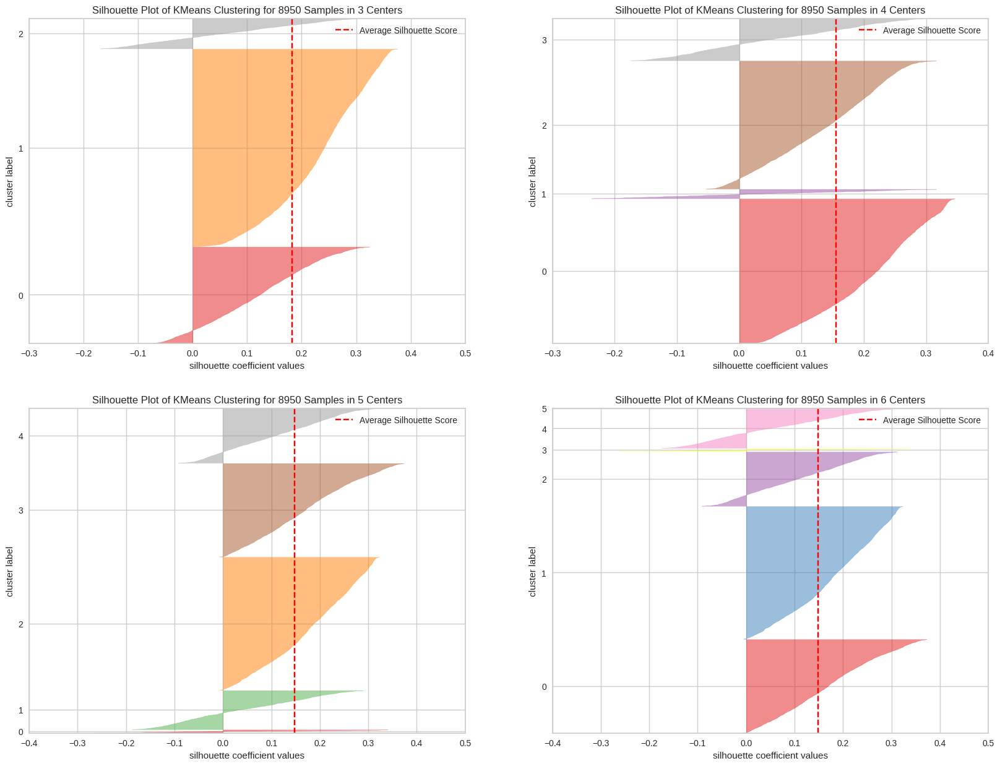

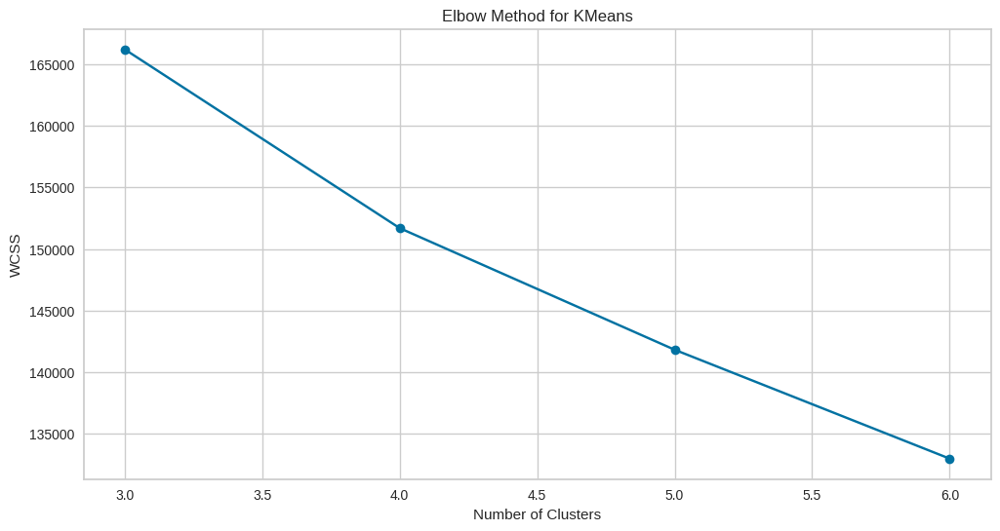

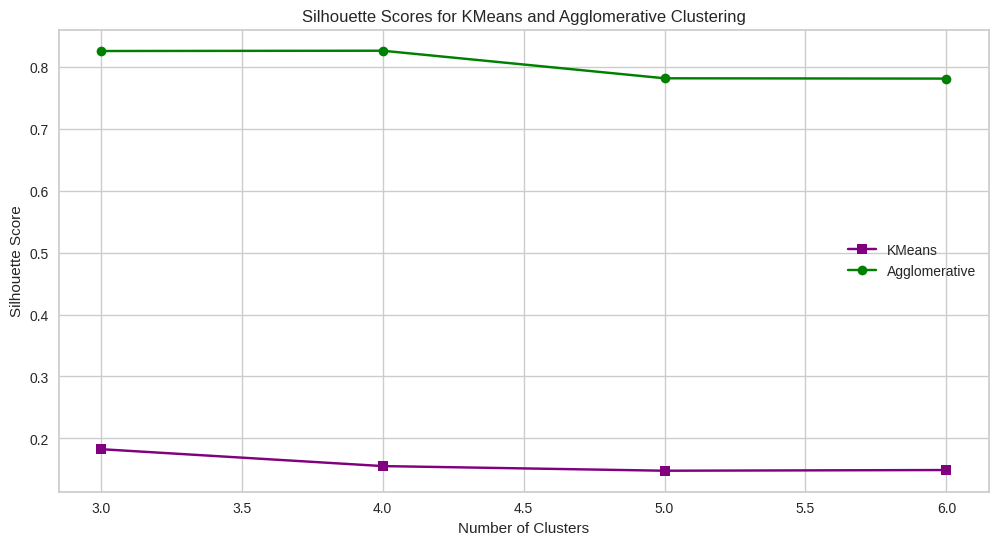

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer

# Silhouette Visualizer for KMeans
fig, axs = plt.subplots(2, 2, figsize=(20, 15))
axs = axs.flatten()
for i, n_clusters in enumerate(range(3, 7)):
    ax = axs[i]
    sil_visualizer = SilhouetteVisualizer(KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42), ax=ax)
    sil_visualizer.fit(pca_data)
    sil_visualizer.finalize()

# Elbow Method Plot for KMeans
plt.figure(figsize=(12, 6))
plt.plot(range(3, 7), wcss, marker='o', color='b')
plt.title('Elbow Method for KMeans')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

# Silhouette Scores for KMeans and Agglomerative Clustering
plt.figure(figsize=(12, 6))
plt.plot(range(3, 7), sil_kmeans, marker='s', color='purple', label='KMeans')
plt.plot(range(3, 7), sil_agc, marker='o', color='green', label='Agglomerative')
plt.title('Silhouette Scores for KMeans and Agglomerative Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.legend()
plt.show()


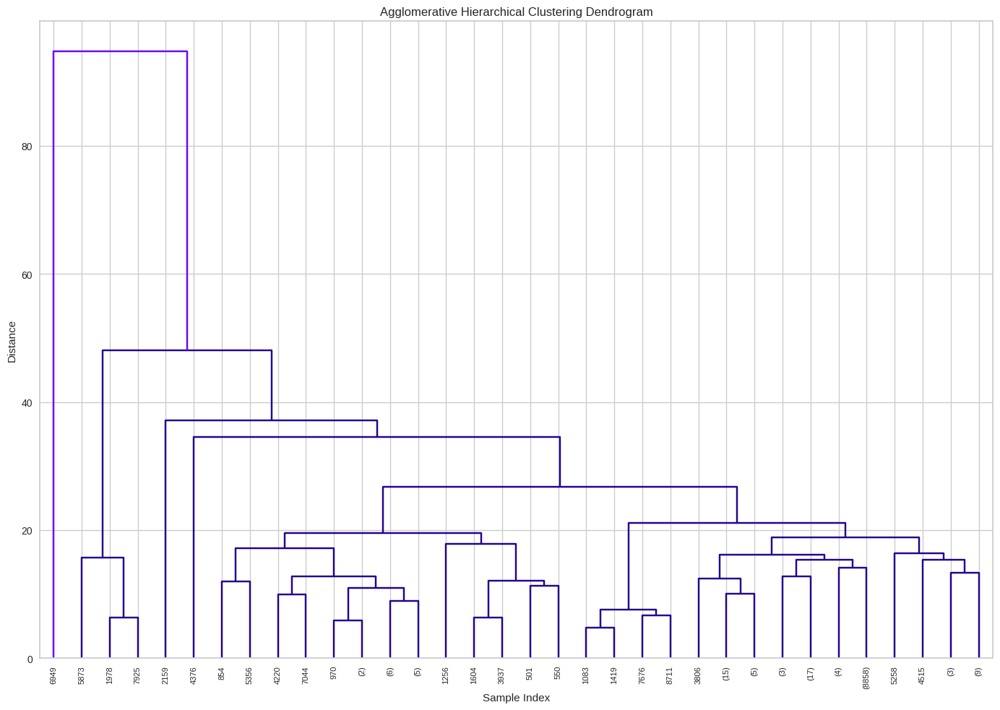

In [ ]:

# Step 4: Plotting the Dendrogram

import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Plotting Dendrogram for Agglomerative Hierarchical Clustering
Z = linkage(pca_data, method='average', metric='euclidean')
plt.figure(figsize=(14, 10))
plt.title('Agglomerative Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
dendrogram(Z, leaf_rotation=90, leaf_font_size=8, truncate_mode='level', p=9)
plt.tight_layout()
plt.show()

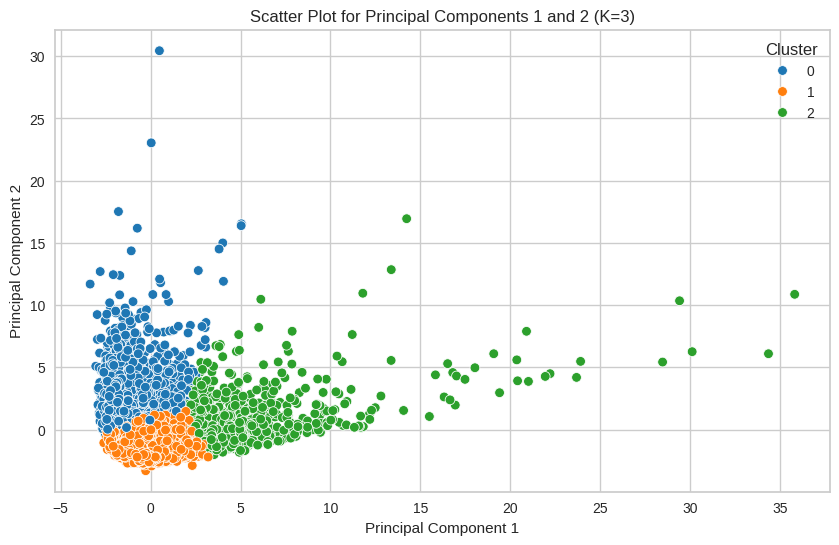

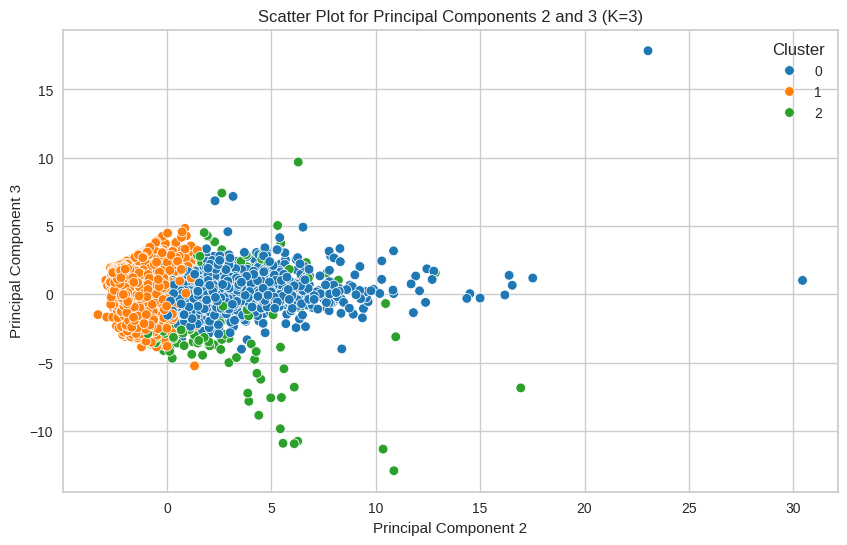

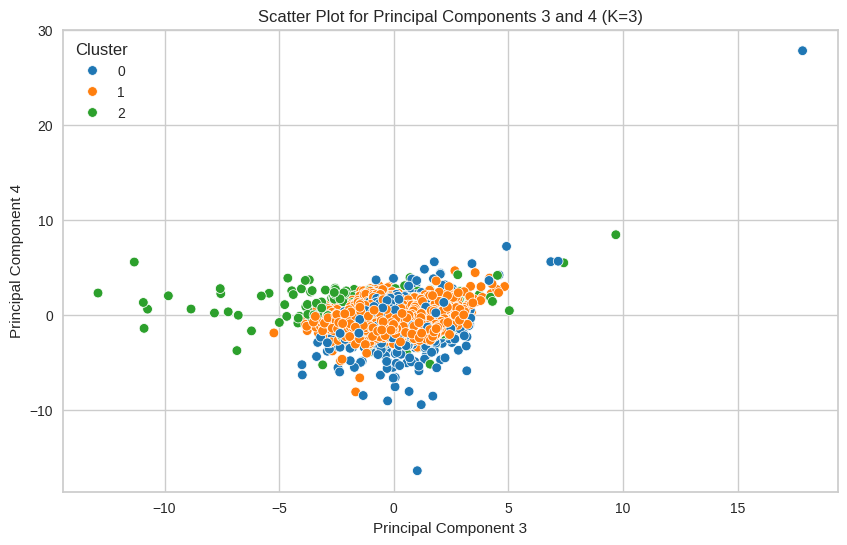

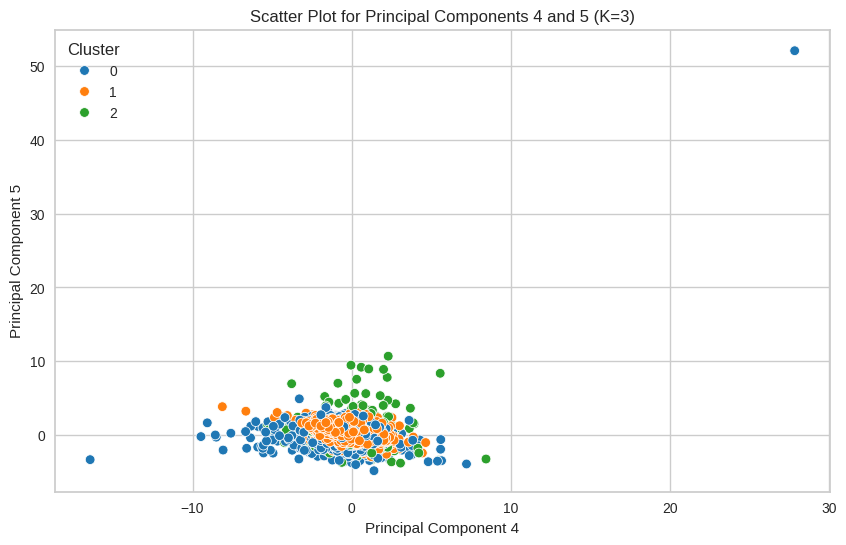

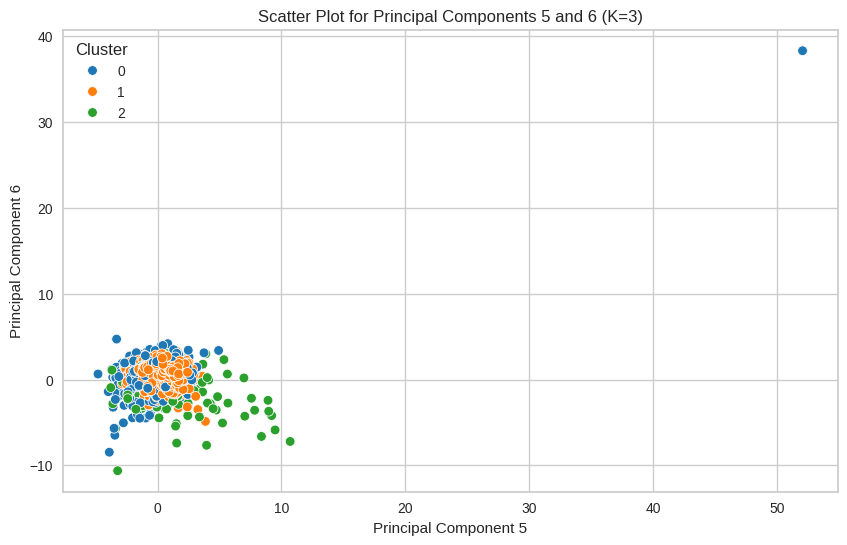

...

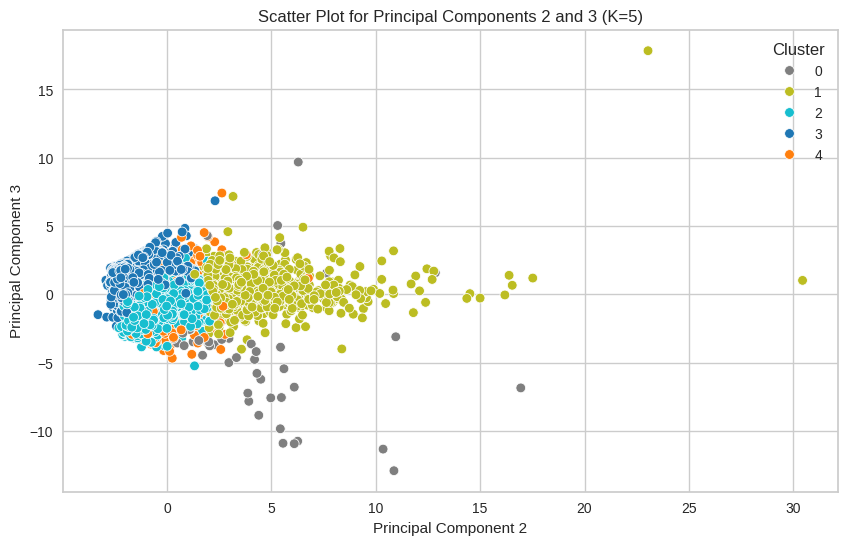

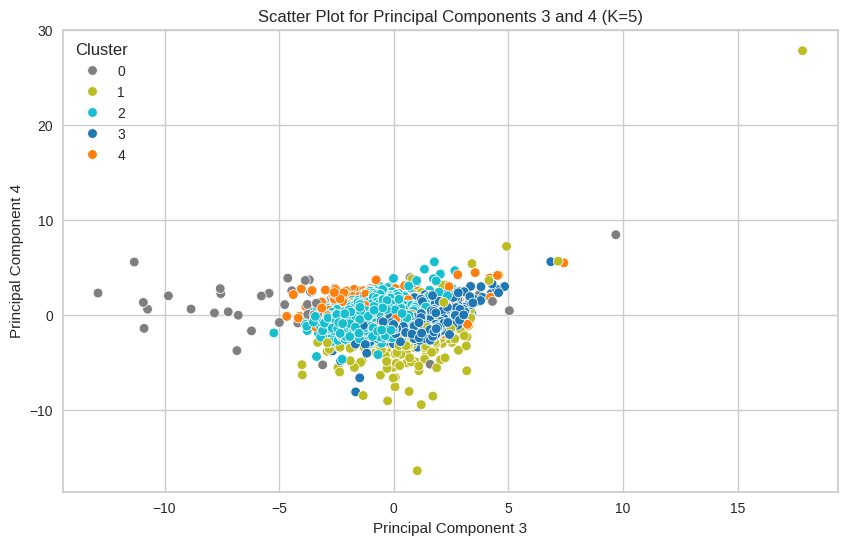

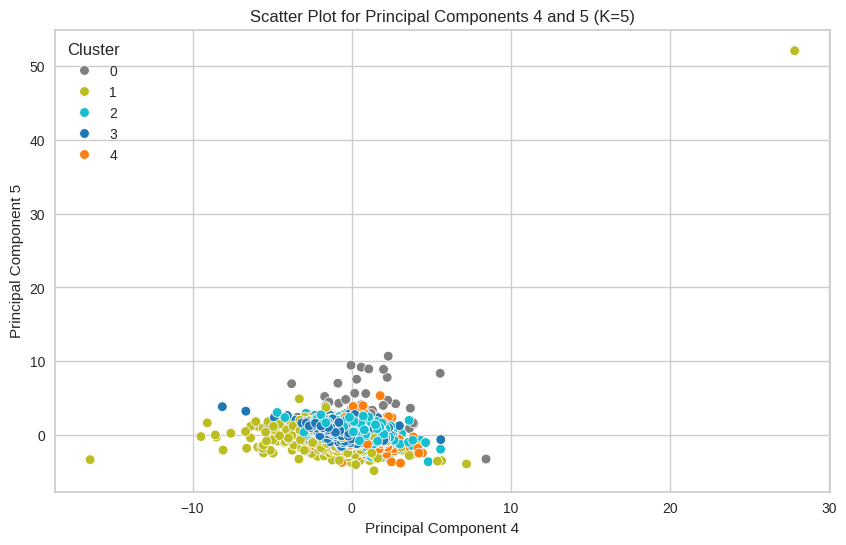

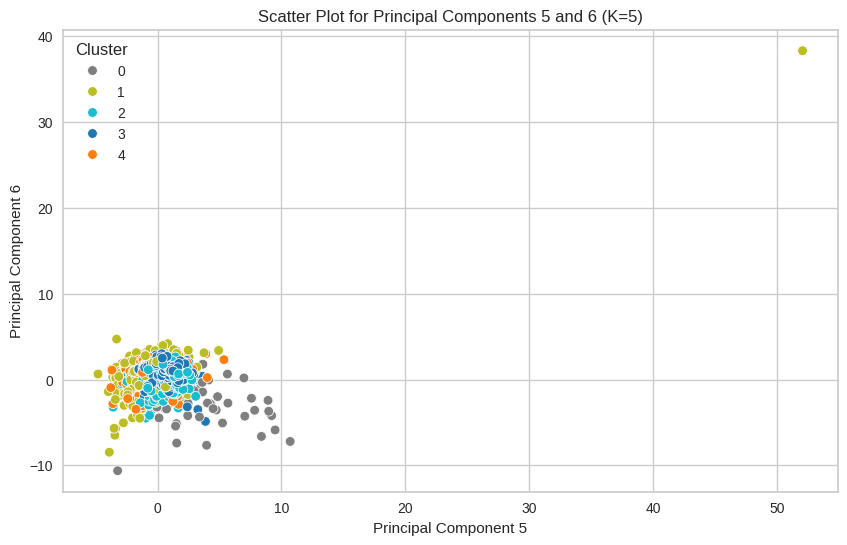

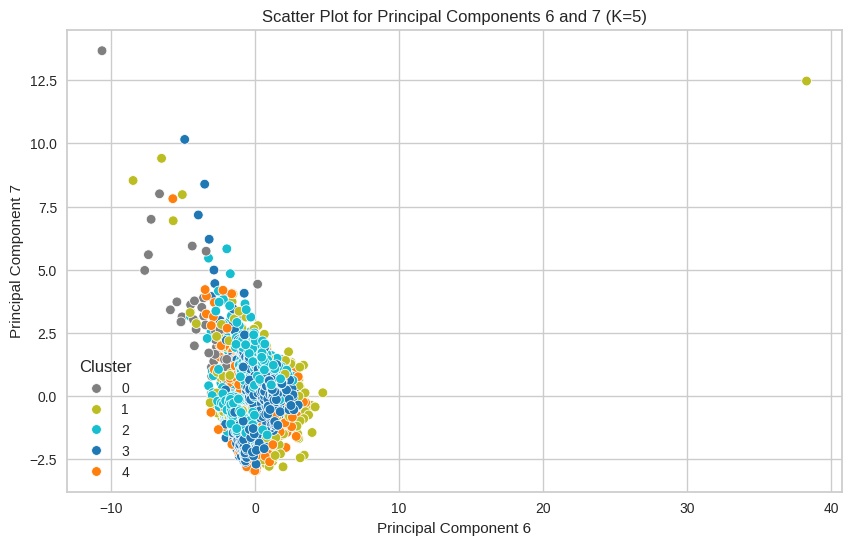

In [ ]:
# Function to apply KMeans clustering and visualize the results
def apply_kmeans_and_visualize(pca_data, n_clusters, palette):
    # Applying KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(pca_data)

    # Creating a DataFrame for PCA data and cluster labels
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
    pca_df['Cluster'] = cluster_labels

    # Visualizing the scatter plots for principal component pairs
    for i in range(min(6, pca_data.shape[1] - 1)):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=pca_df[f'PC{i+1}'], y=pca_df[f'PC{i+2}'], hue=pca_df['Cluster'], palette=palette)
        plt.title(f'Scatter Plot for Principal Components {i+1} and {i+2} (K={n_clusters})')
        plt.xlabel(f'Principal Component {i+1}')
        plt.ylabel(f'Principal Component {i+2}')
        plt.legend(title='Cluster')
        plt.show()

# Applying KMeans clustering and visualizing for 3, 4, and 5 clusters
apply_kmeans_and_visualize(pca_data, n_clusters=3, palette=['#1f77b4', '#ff7f0e', '#2ca02c'])  # Blue, Orange, Green
apply_kmeans_and_visualize(pca_data, n_clusters=4, palette=['#d62728', '#9467bd', '#8c564b', '#e377c2'])  # Red, Purple, Brown, Pink
apply_kmeans_and_visualize(pca_data, n_clusters=5, palette=['#7f7f7f', '#bcbd22', '#17becf', '#1f77b4', '#ff7f0e'])  # Gray, Olive, Cyan, Blue, Orange


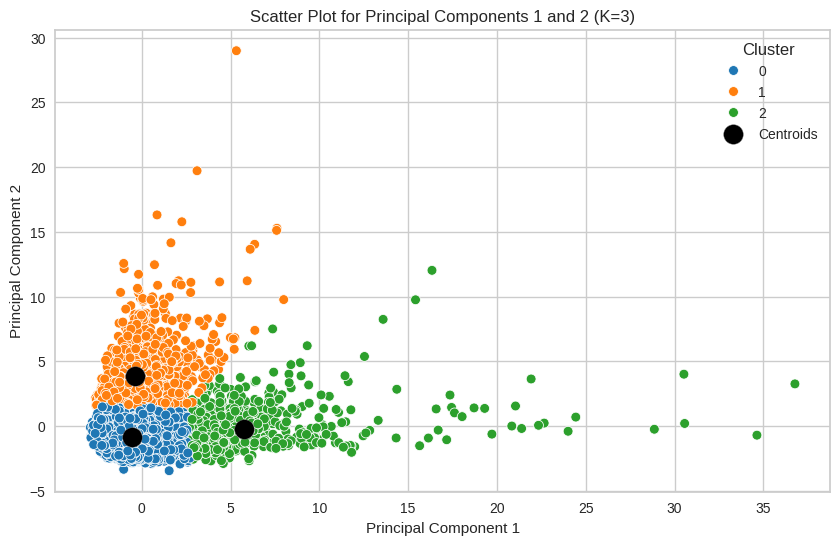

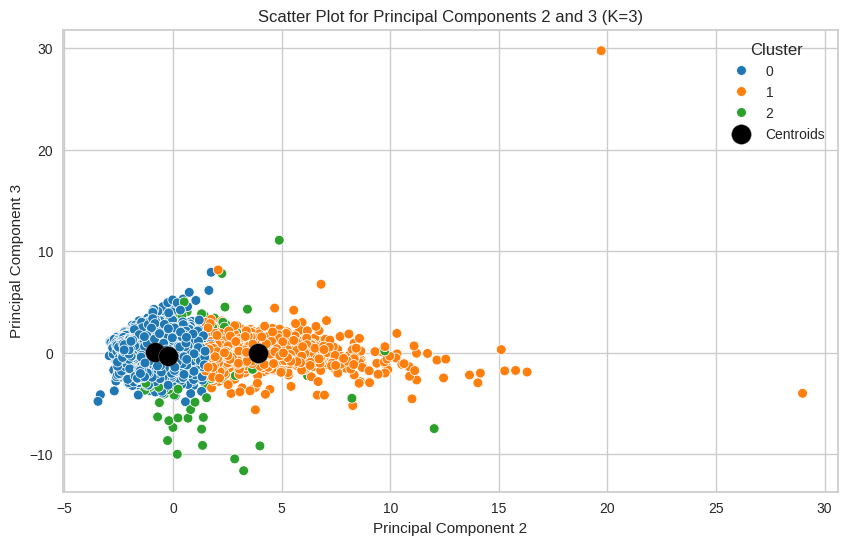

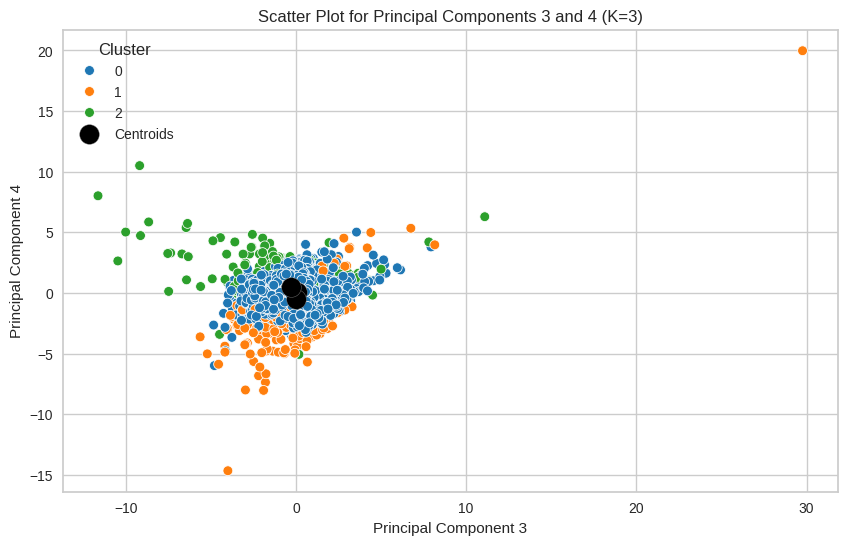

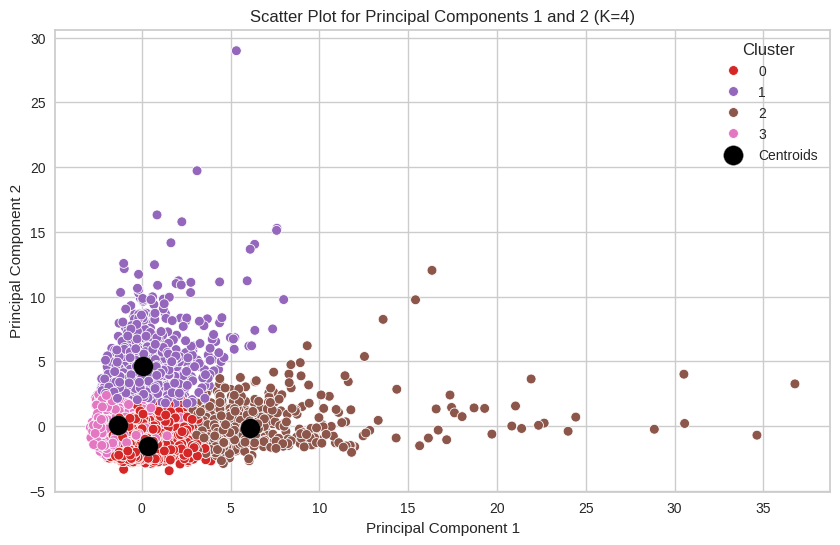

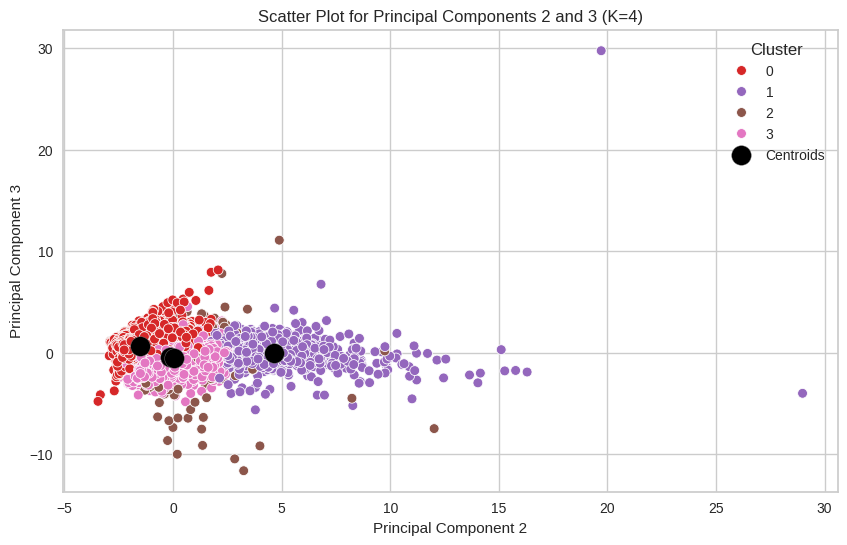

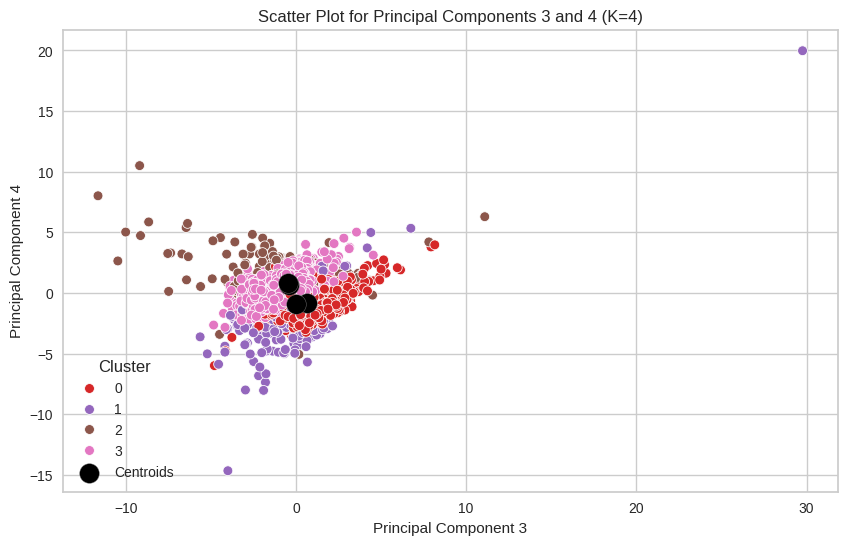

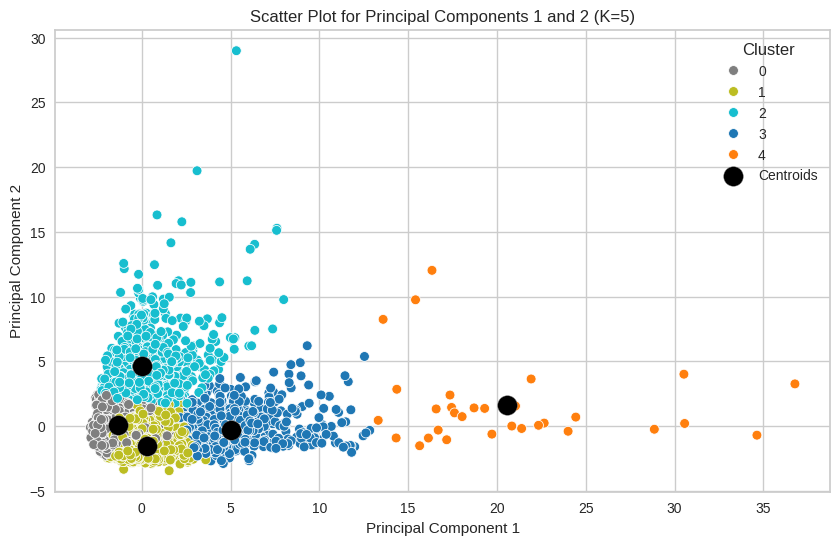

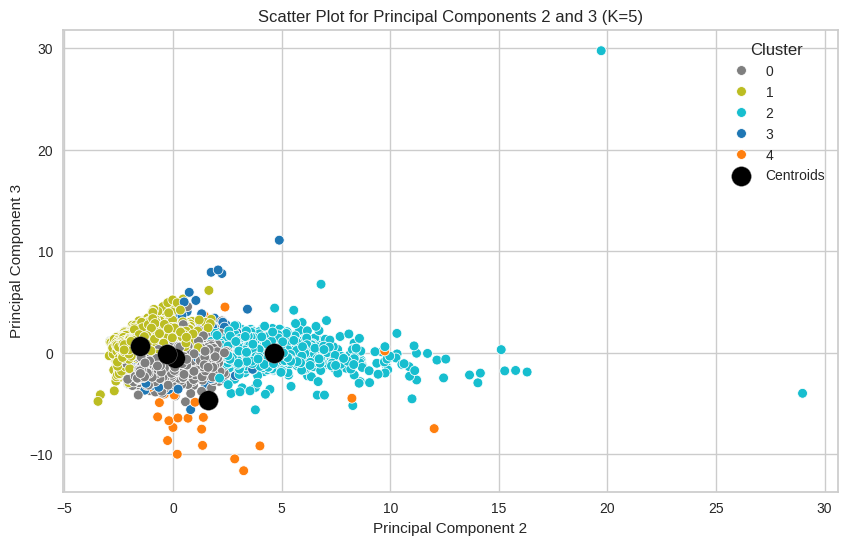

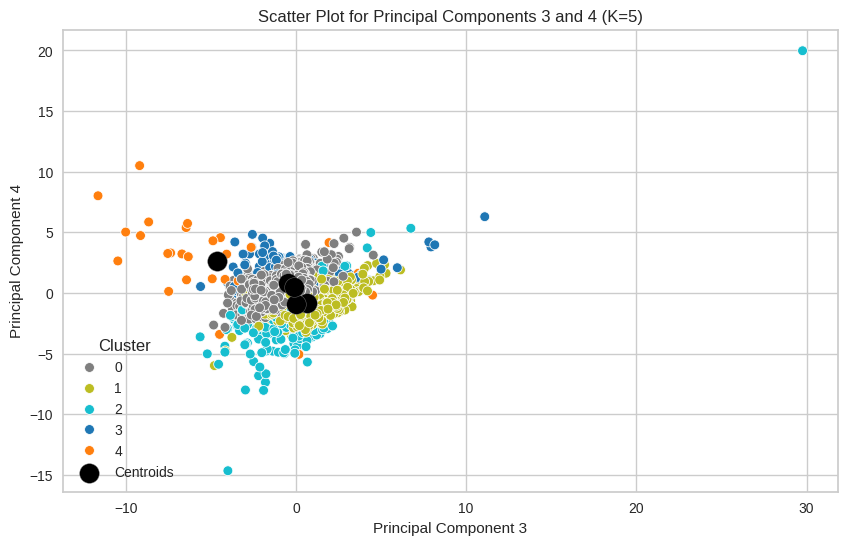

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer

# Function to apply KMeans clustering and visualize the results
def apply_kmeans_and_visualize(pca_data, n_clusters, palette):
    # Applying KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(pca_data)
    centroids = kmeans.cluster_centers_

    # Creating a DataFrame for PCA data and cluster labels
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
    pca_df['Cluster'] = cluster_labels
    centroids_df = pd.DataFrame(centroids, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])

    # Visualizing the scatter plots for principal component pairs
    for i in range(min(6, pca_data.shape[1] - 1)):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=pca_df[f'PC{i+1}'], y=pca_df[f'PC{i+2}'], hue=pca_df['Cluster'], palette=palette, s=50)
        plt.scatter(centroids[:, i], centroids[:, i+1], c='black', edgecolor='grey', s=200, label='Centroids')
        plt.title(f'Scatter Plot for Principal Components {i+1} and {i+2} (K={n_clusters})')
        plt.xlabel(f'Principal Component {i+1}')
        plt.ylabel(f'Principal Component {i+2}')
        plt.legend(title='Cluster')
        plt.show()

# Assuming dataset is already loaded and processed with numeric columns only

# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=4)
pca_data = pca.fit_transform(scaled_data)

# Applying KMeans clustering and visualizing for 3, 4, and 5 clusters
apply_kmeans_and_visualize(pca_data, n_clusters=3, palette=['#1f77b4', '#ff7f0e', '#2ca02c'])  # Blue, Orange, Green
apply_kmeans_and_visualize(pca_data, n_clusters=4, palette=['#d62728', '#9467bd', '#8c564b', '#e377c2'])  # Red, Purple, Brown, Pink
apply_kmeans_and_visualize(pca_data, n_clusters=5, palette=['#7f7f7f', '#bcbd22', '#17becf', '#1f77b4', '#ff7f0e'])  # Gray, Olive, Cyan, Blue, Orange


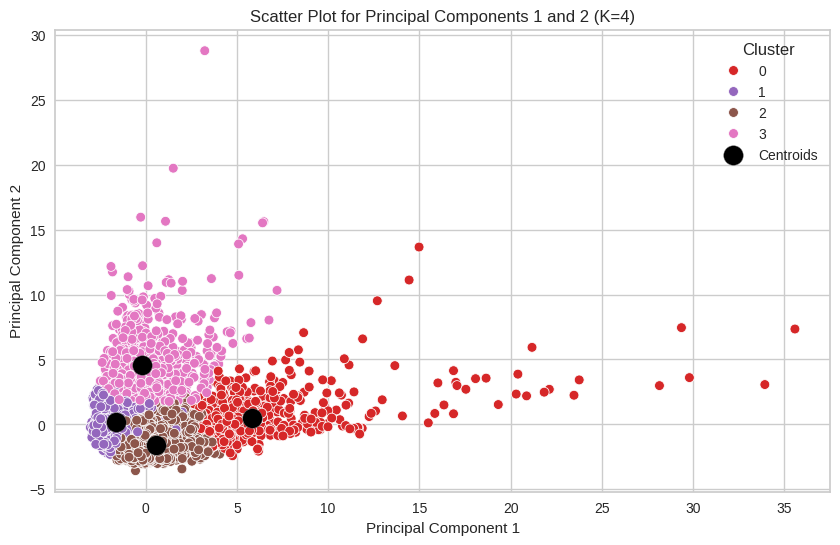

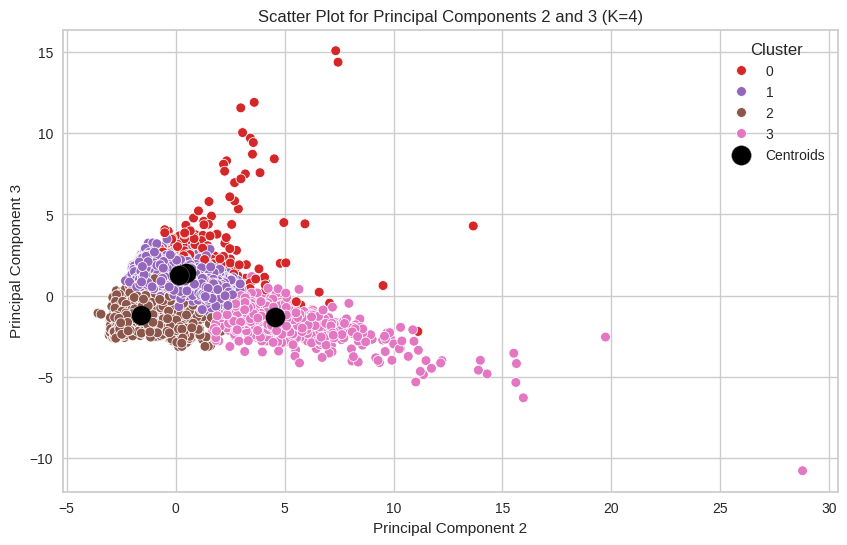

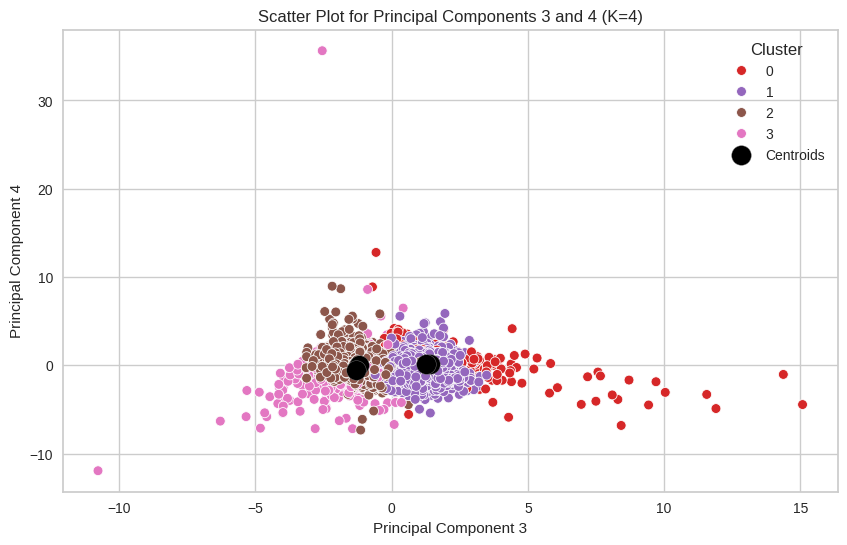

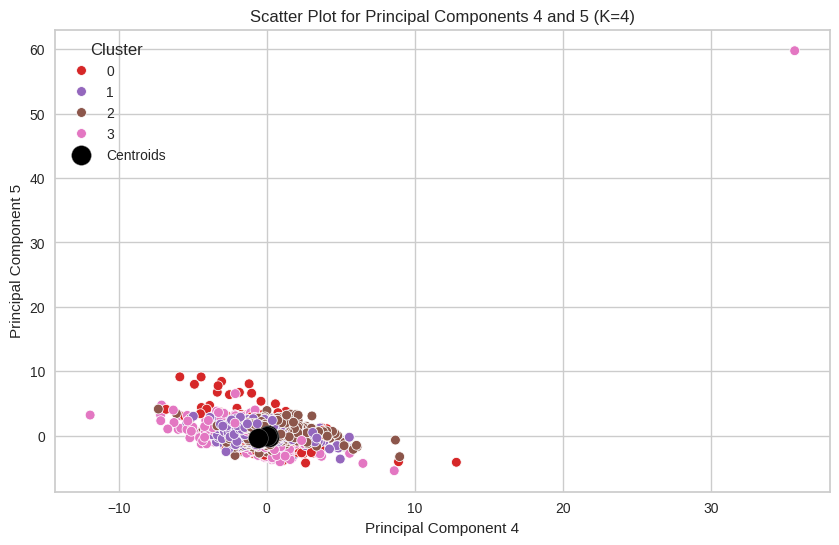

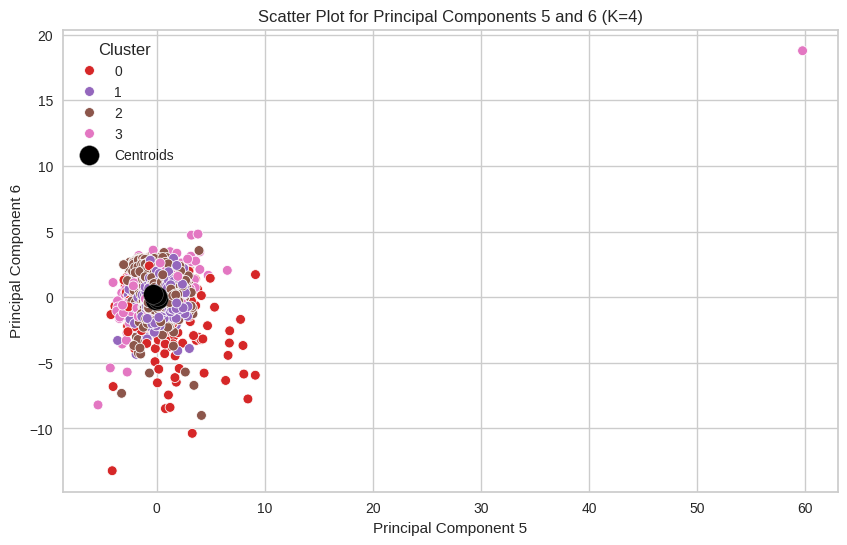

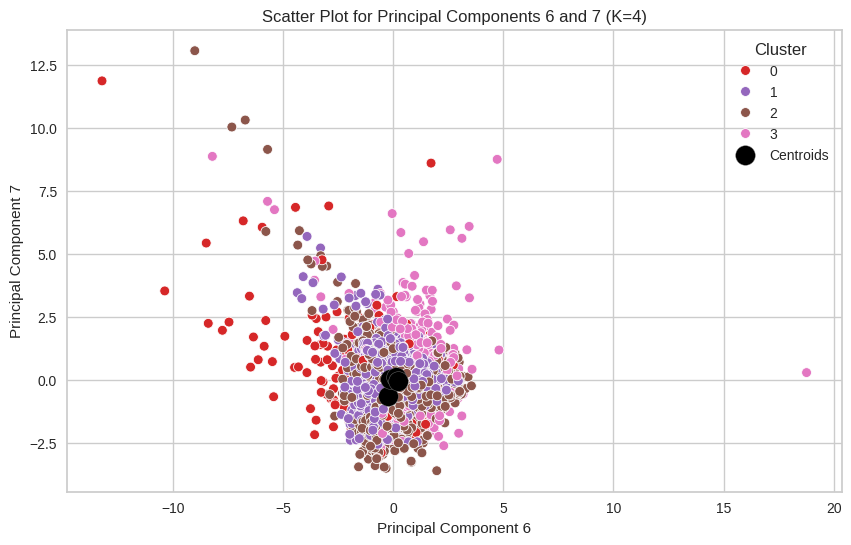

In [ ]:
#only for cluster group 4 and between all 7 PCs

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer

# Function to apply KMeans clustering and visualize the results
def apply_kmeans_and_visualize(pca_data, n_clusters, palette):
    # Applying KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(pca_data)
    centroids = kmeans.cluster_centers_

    # Creating a DataFrame for PCA data and cluster labels
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
    pca_df['Cluster'] = cluster_labels
    centroids_df = pd.DataFrame(centroids, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])

    # Visualizing the scatter plots for principal component pairs
    for i in range(pca_data.shape[1] - 1):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=pca_df[f'PC{i+1}'], y=pca_df[f'PC{i+2}'], hue=pca_df['Cluster'], palette=palette, s=50)
        plt.scatter(centroids[:, i], centroids[:, i+1], c='black', edgecolor='grey', s=200, label='Centroids')
        plt.title(f'Scatter Plot for Principal Components {i+1} and {i+2} (K={n_clusters})')
        plt.xlabel(f'Principal Component {i+1}')
        plt.ylabel(f'Principal Component {i+2}')
        plt.legend(title='Cluster')
        plt.show()

# Assuming dataset is already loaded and processed with numeric columns only

# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=7)  # Using 7 principal components
pca_data = pca.fit_transform(scaled_data)

# Applying KMeans clustering and visualizing for 4 clusters
apply_kmeans_and_visualize(pca_data, n_clusters=4, palette=['#d62728', '#9467bd', '#8c564b', '#e377c2'])  # Red, Purple, Brown, Pink


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer
import plotly.express as px

# Function to apply KMeans clustering and visualize the results
def apply_kmeans_and_visualize_3d(pca_data, n_clusters, palette):
    # Applying KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(pca_data)
    centroids = kmeans.cluster_centers_

    # Creating a DataFrame for PCA data and cluster labels
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
    pca_df['Cluster'] = cluster_labels
    centroids_df = pd.DataFrame(centroids, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])

    # Visualizing the 3D scatter plots for the first three principal components
    fig = px.scatter_3d(
        pca_df, x='PC1', y='PC2', z='PC3',
        color='Cluster',
        color_discrete_sequence=palette,
        title=f'3D Scatter Plot for Principal Components 1, 2, and 3 (K={n_clusters})'
    )
    fig.add_trace(
        px.scatter_3d(
            centroids_df, x='PC1', y='PC2', z='PC3',
            size=[10]*n_clusters, color_discrete_sequence=['black'],
            text=[f'Centroid {i}' for i in range(n_clusters)]
        ).data[0]
    )
    fig.show()

# Assuming dataset is already loaded and processed with numeric columns only

# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=4)
pca_data = pca.fit_transform(scaled_data)

# Applying KMeans clustering and visualizing for 3 clusters
apply_kmeans_and_visualize_3d(pca_data, n_clusters=3, palette=['#1f77b4', '#ff7f0e', '#2ca02c'])  # Blue, Orange, Green


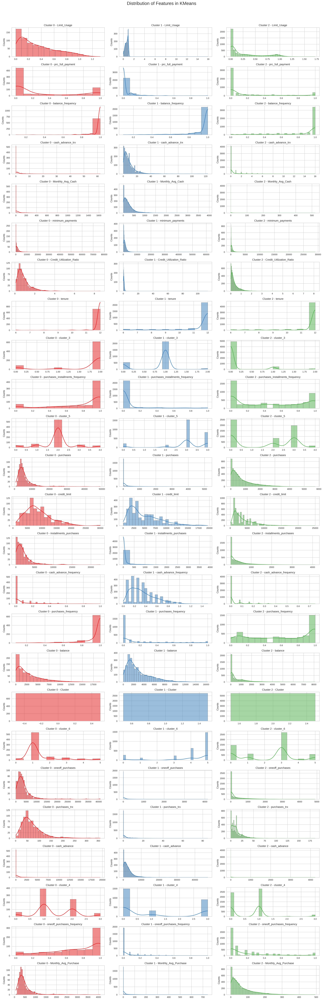

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer

# Function to identify main contributing features
def get_main_features(pca, feature_names, top_n=5):
    main_features = []
    for i in range(pca.components_.shape[0]):
        component = pca.components_[i]
        indices = np.argsort(np.abs(component))[-top_n:]
        main_features.extend(feature_names[indices])
    return list(set(main_features))

# Function to plot histograms for main features by clusters
def plot_histograms_by_cluster(data, cluster_labels, main_features):
    data['Cluster'] = cluster_labels
    num_features = len(main_features)
    num_clusters = data['Cluster'].nunique()
    fig, axes = plt.subplots(num_features, num_clusters, figsize=(20, 60), dpi=200)

    for i, feature in enumerate(main_features):
        for j, cluster in enumerate(sorted(data['Cluster'].unique())):
            sns.histplot(data=data[data['Cluster'] == cluster], x=feature, kde=True, ax=axes[i, j], color=sns.color_palette("Set1")[cluster])
            axes[i, j].set_title(f'Cluster {cluster} - {feature}')
            axes[i, j].set_xlabel('')
            axes[i, j].set_ylabel('Counts')

    plt.tight_layout()
    plt.suptitle('Distribution of Features in KMeans', y=1.02, fontsize=20)
    plt.show()

# Load and process the dataset (assuming dataset is your DataFrame)
# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=7)
pca_data = pca.fit_transform(scaled_data)

# Identify main contributing features
feature_names = dataset.select_dtypes(include=[np.number]).columns
main_features = get_main_features(pca, feature_names, top_n=5)

# Apply KMeans clustering for 3 clusters
kmeans = KMeans(n_clusters=3, n_init=100, init='k-means++', random_state=42)
cluster_labels = kmeans.fit_predict(scaled_data)

# Plot histograms for the main contributing features
plot_histograms_by_cluster(dataset, cluster_labels, main_features)


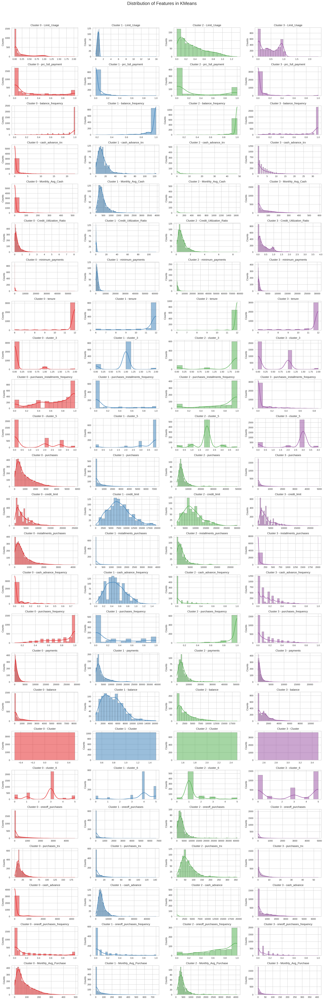

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer

# Function to identify main contributing features
def get_main_features(pca, feature_names, top_n=5):
    main_features = []
    for i in range(pca.components_.shape[0]):
        component = pca.components_[i]
        indices = np.argsort(np.abs(component))[-top_n:]
        main_features.extend(feature_names[indices])
    return list(set(main_features))

# Function to plot histograms for main features by clusters
def plot_histograms_by_cluster(data, cluster_labels, main_features):
    data['Cluster'] = cluster_labels
    num_features = len(main_features)
    num_clusters = data['Cluster'].nunique()
    fig, axes = plt.subplots(num_features, num_clusters, figsize=(20, 60), dpi=200)

    for i, feature in enumerate(main_features):
        for j, cluster in enumerate(sorted(data['Cluster'].unique())):
            sns.histplot(data=data[data['Cluster'] == cluster], x=feature, kde=True, ax=axes[i, j], color=sns.color_palette("Set1")[cluster])
            axes[i, j].set_title(f'Cluster {cluster} - {feature}')
            axes[i, j].set_xlabel('')
            axes[i, j].set_ylabel('Counts')

    plt.tight_layout()
    plt.suptitle('Distribution of Features in KMeans', y=1.02, fontsize=20)
    plt.show()

# Load and process the dataset (assuming dataset is your DataFrame)
# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=7)
pca_data = pca.fit_transform(scaled_data)

# Identify main contributing features
feature_names = dataset.select_dtypes(include=[np.number]).columns
main_features = get_main_features(pca, feature_names, top_n=5)

# Apply KMeans clustering for 4 clusters
kmeans = KMeans(n_clusters=4, n_init=100, init='k-means++', random_state=42)
cluster_labels = kmeans.fit_predict(scaled_data)

# Plot histograms for the main contributing features
plot_histograms_by_cluster(dataset, cluster_labels, main_features)


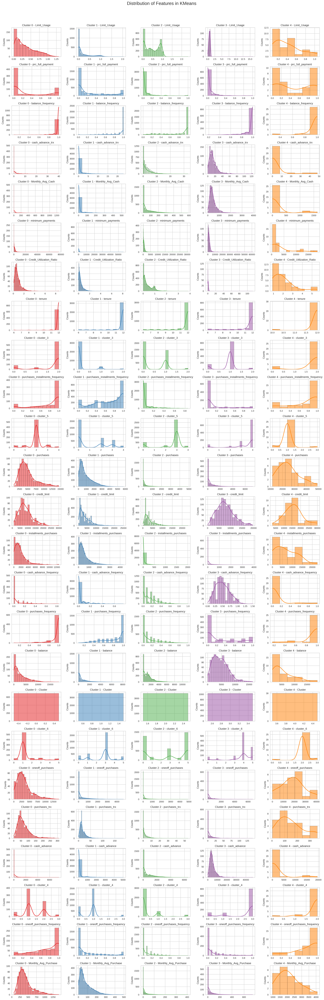

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer

# Function to identify main contributing features
def get_main_features(pca, feature_names, top_n=5):
    main_features = []
    for i in range(pca.components_.shape[0]):
        component = pca.components_[i]
        indices = np.argsort(np.abs(component))[-top_n:]
        main_features.extend(feature_names[indices])
    return list(set(main_features))

# Function to plot histograms for main features by clusters
def plot_histograms_by_cluster(data, cluster_labels, main_features):
    data['Cluster'] = cluster_labels
    num_features = len(main_features)
    num_clusters = data['Cluster'].nunique()
    fig, axes = plt.subplots(num_features, num_clusters, figsize=(20, 60), dpi=200)

    for i, feature in enumerate(main_features):
        for j, cluster in enumerate(sorted(data['Cluster'].unique())):
            sns.histplot(data=data[data['Cluster'] == cluster], x=feature, kde=True, ax=axes[i, j], color=sns.color_palette("Set1")[cluster])
            axes[i, j].set_title(f'Cluster {cluster} - {feature}')
            axes[i, j].set_xlabel('')
            axes[i, j].set_ylabel('Counts')

    plt.tight_layout()
    plt.suptitle('Distribution of Features in KMeans', y=1.02, fontsize=20)
    plt.show()

# Load and process the dataset (assuming dataset is your DataFrame)
# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=7)
pca_data = pca.fit_transform(scaled_data)

# Identify main contributing features
feature_names = dataset.select_dtypes(include=[np.number]).columns
main_features = get_main_features(pca, feature_names, top_n=5)

# Apply KMeans clustering for 5 clusters
kmeans = KMeans(n_clusters=5, n_init=100, init='k-means++', random_state=42)
cluster_labels = kmeans.fit_predict(scaled_data)

# Plot histograms for the main contributing features
plot_histograms_by_cluster(dataset, cluster_labels, main_features)


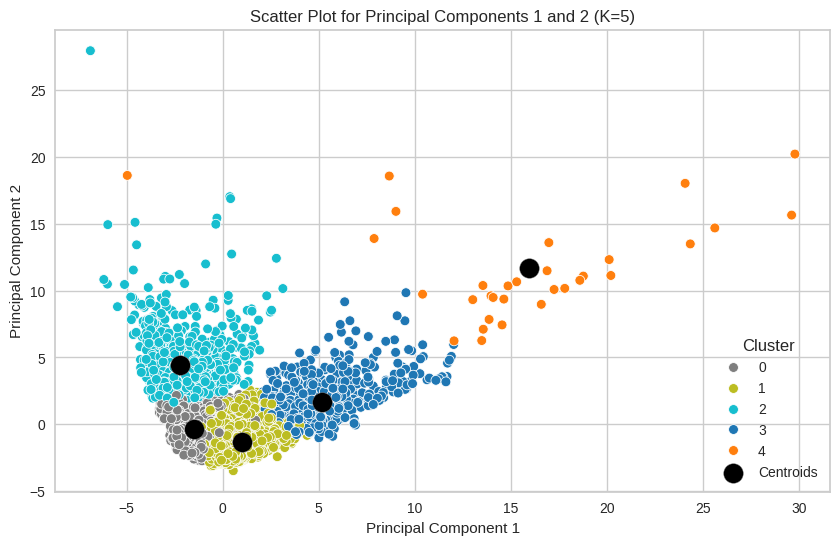

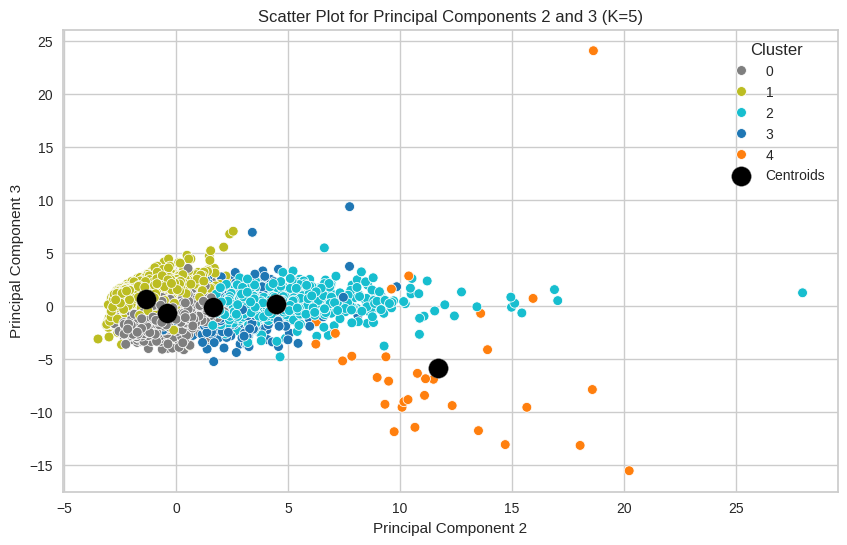

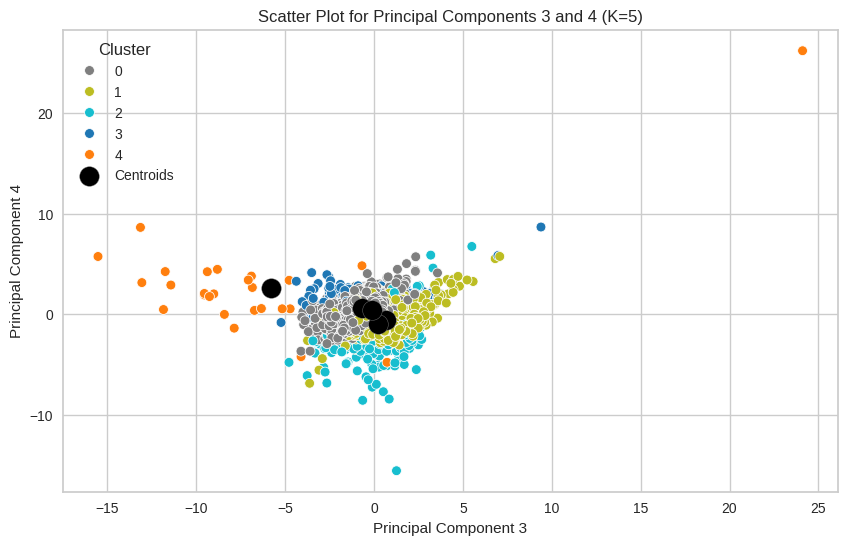

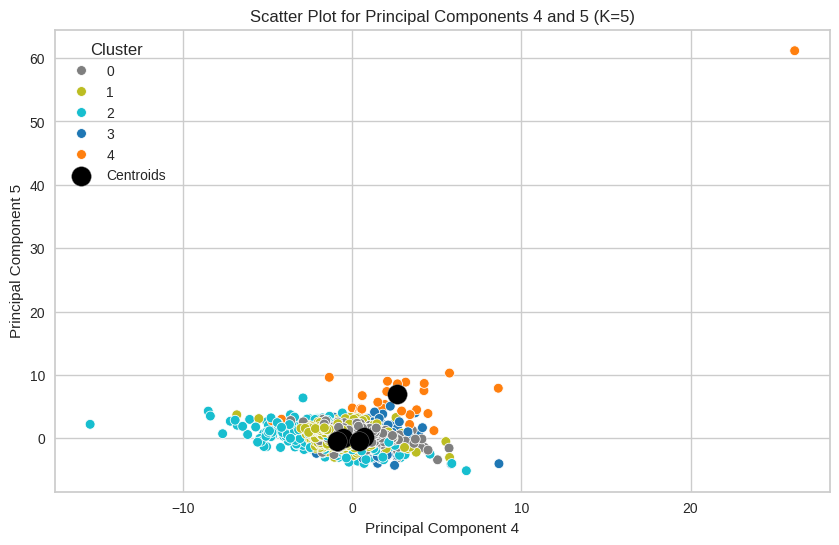

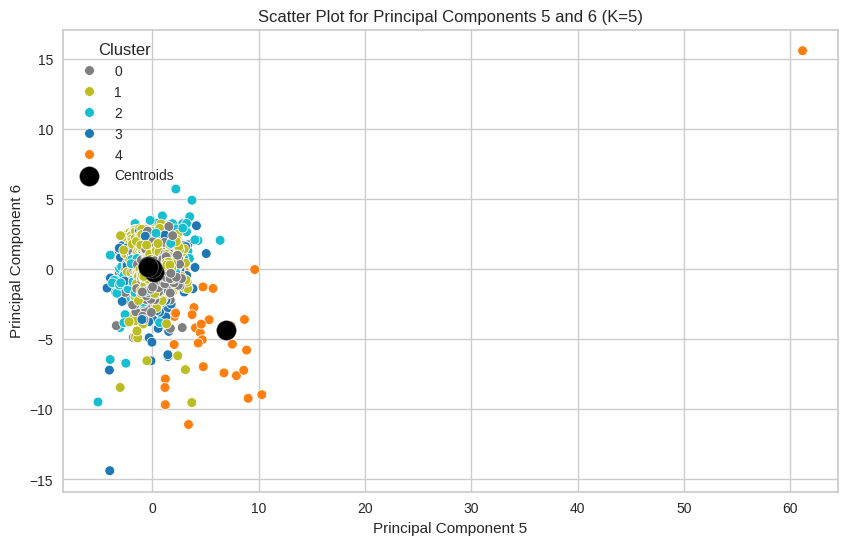

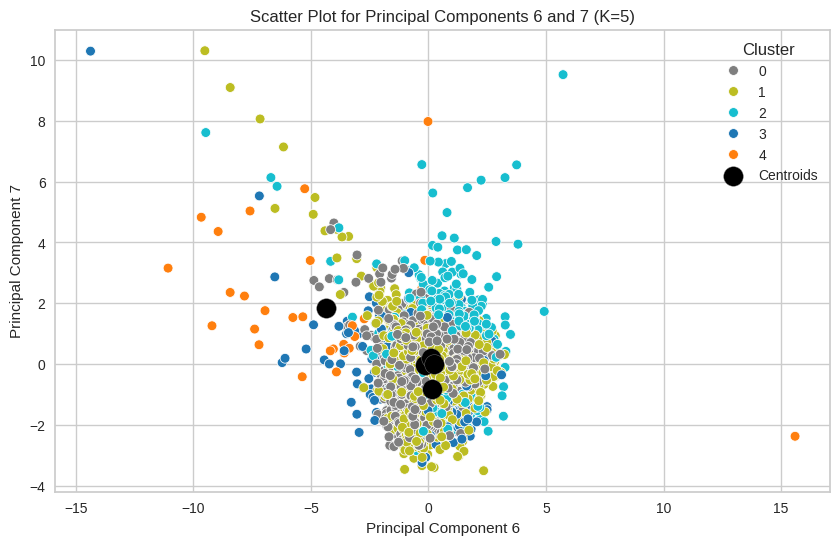

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer

# Function to apply KMeans clustering and visualize the results
def apply_kmeans_and_visualize(pca_data, n_clusters, palette):
    # Applying KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(pca_data)
    centroids = kmeans.cluster_centers_

    # Creating a DataFrame for PCA data and cluster labels
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
    pca_df['Cluster'] = cluster_labels
    centroids_df = pd.DataFrame(centroids, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])

    # Visualizing the scatter plots for principal component pairs
    for i in range(pca_data.shape[1] - 1):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=pca_df[f'PC{i+1}'], y=pca_df[f'PC{i+2}'], hue=pca_df['Cluster'], palette=palette, s=50)
        plt.scatter(centroids[:, i], centroids[:, i+1], c='black', edgecolor='grey', s=200, label='Centroids')
        plt.title(f'Scatter Plot for Principal Components {i+1} and {i+2} (K={n_clusters})')
        plt.xlabel(f'Principal Component {i+1}')
        plt.ylabel(f'Principal Component {i+2}')
        plt.legend(title='Cluster')
        plt.show()

# Assuming dataset is already loaded and processed with numeric columns only

# Handle missing values
imputer = SimpleImputer(strategy='mean')
imputed_data = imputer.fit_transform(dataset.select_dtypes(include=[np.number]))

# Standardize the dataset
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_data)

# Apply PCA
pca = PCA(n_components=7)  # Using 7 principal components
pca_data = pca.fit_transform(scaled_data)

# Applying KMeans clustering and visualizing for 5 clusters
apply_kmeans_and_visualize(pca_data, n_clusters=5, palette=['#7f7f7f', '#bcbd22', '#17becf', '#1f77b4', '#ff7f0e'])  # Gray, Olive, Cyan, Blue, Orange


In [ ]:
print(f"Length of dataset: {len(dataset)}")
print(f"Length of pca_data_7: {len(pca_data_7)}")

# Function to apply KMeans clustering and append labels
def apply_kmeans_and_append_labels(data, pca_data, n_clusters):
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    kmeans_labels = kmeans.fit_predict(pca_data)
    data[f'cluster_{n_clusters}'] = kmeans_labels
    return data

if len(dataset) != len(pca_data_7):
    min_length = min(len(dataset), len(pca_data_7))
    dataset = dataset.iloc[:min_length]
    pca_data_7 = pca_data_7[:min_length]

# Ensure the lengths match before proceeding
if len(dataset) == len(pca_data_7):
    for n_clusters in range(3, 7):
        dataset = apply_kmeans_and_append_labels(dataset, pca_data_7, n_clusters)
else:
    print("Length mismatch between dataset and PCA data.")
    min_length = min(len(dataset), len(pca_data_7))
    dataset = dataset.iloc[:min_length]
    pca_data_7 = pca_data_7[:min_length]
    for n_clusters in range(3, 7):
        dataset = apply_kmeans_and_append_labels(dataset, pca_data_7, n_clusters)

# Display the dataset with the appended cluster labels
print(dataset.head())


Length of dataset: 8949
Length of pca_data_7: 8950
       balance  balance_frequency  purchases  oneoff_purchases  \
0    40.900749           0.818182      95.40              0.00   
1  3202.467416           0.909091       0.00              0.00   
2  2495.148862           1.000000     773.17            773.17   
3  1666.670542           0.636364    1499.00           1499.00   
4   817.714335           1.000000      16.00             16.00   

   installments_purchases  cash_advance  purchases_frequency  \
0                    95.4      0.000000             0.166667   
1                     0.0   6442.945483             0.000000   
2                     0.0      0.000000             1.000000   
3                     0.0    205.788017             0.083333   
4                     0.0      0.000000             0.083333   

   oneoff_purchases_frequency  purchases_installments_frequency  \
0                    0.000000                          0.083333   
1                    0.000000    

In [ ]:
# Function to compute segment distribution
def compute_segment_distribution(data, n_clusters):
    cluster_col = f'cluster_{n_clusters}'
    distribution = data[cluster_col].value_counts(normalize=True).sort_index()
    return distribution

# Compute and display segment distribution for 3 to 6 clusters
for n_clusters in range(3, 7):
    try:
        distribution = compute_segment_distribution(dataset, n_clusters)
        print(f'Segment Distribution for {n_clusters} clusters:\n', distribution)
    except KeyError as e:
        print(f"Error: {e} - Check if the cluster column 'cluster_{n_clusters}' exists.")


Segment Distribution for 3 clusters:
 cluster_3
0    0.616158
1    0.296234
2    0.087608
Name: proportion, dtype: float64
Segment Distribution for 4 clusters:
 cluster_4
0    0.446419
1    0.394011
2    0.032853
3    0.126718
Name: proportion, dtype: float64
Segment Distribution for 5 clusters:
 cluster_5
0    0.307409
1    0.009163
2    0.169404
3    0.397810
4    0.116214
Name: proportion, dtype: float64
Segment Distribution for 6 clusters:
 cluster_6
0    0.196000
1    0.141804
2    0.008716
3    0.333222
4    0.088837
5    0.231423
Name: proportion, dtype: float64


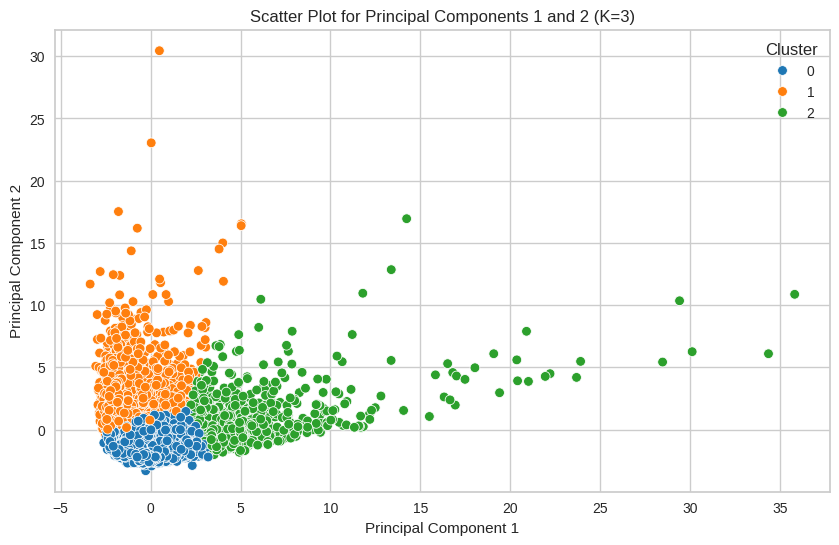

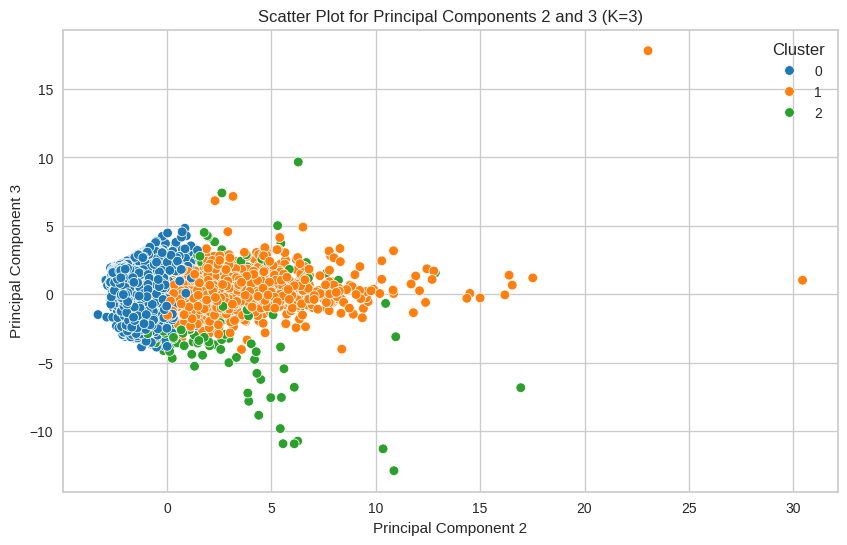

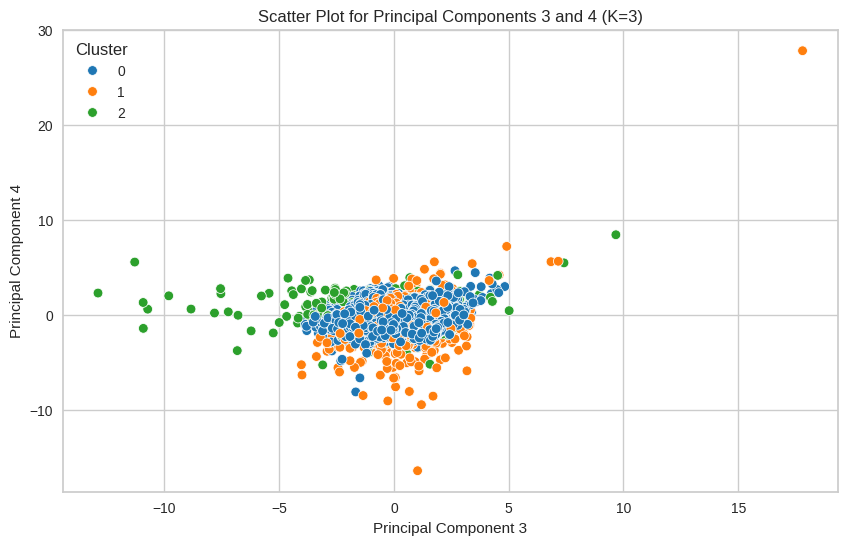

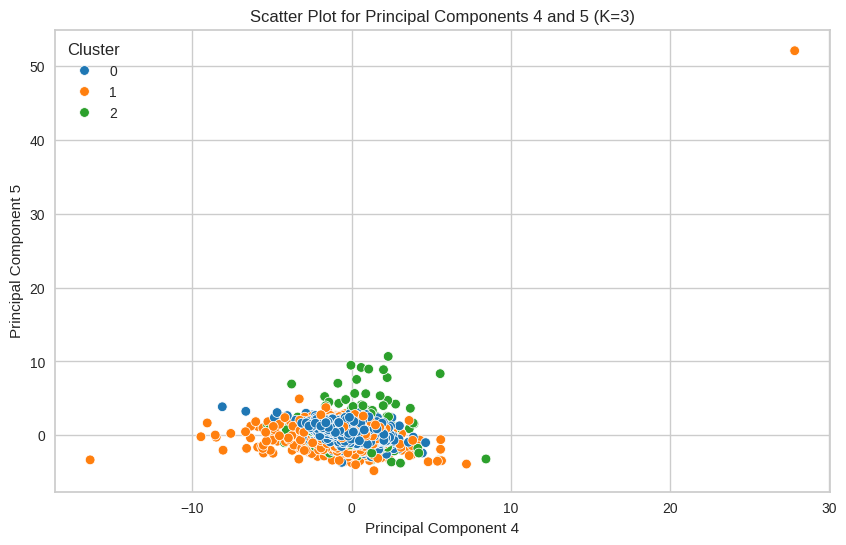

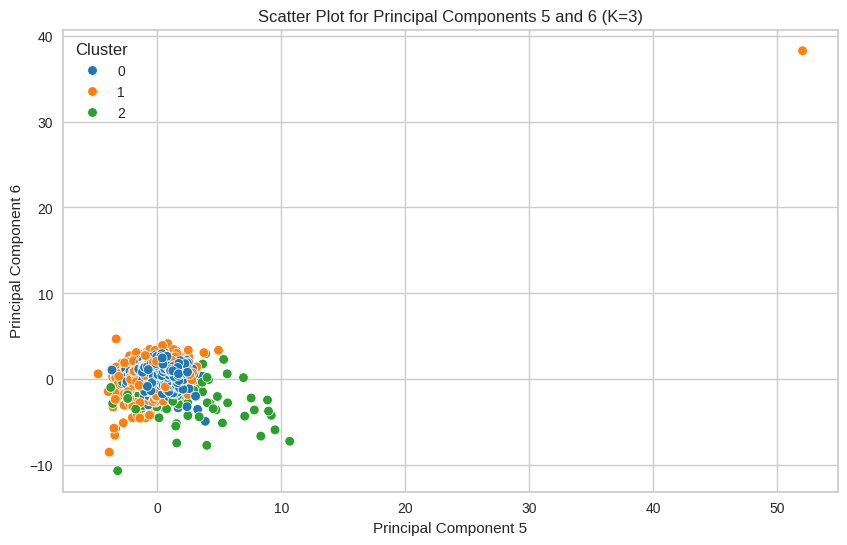

...

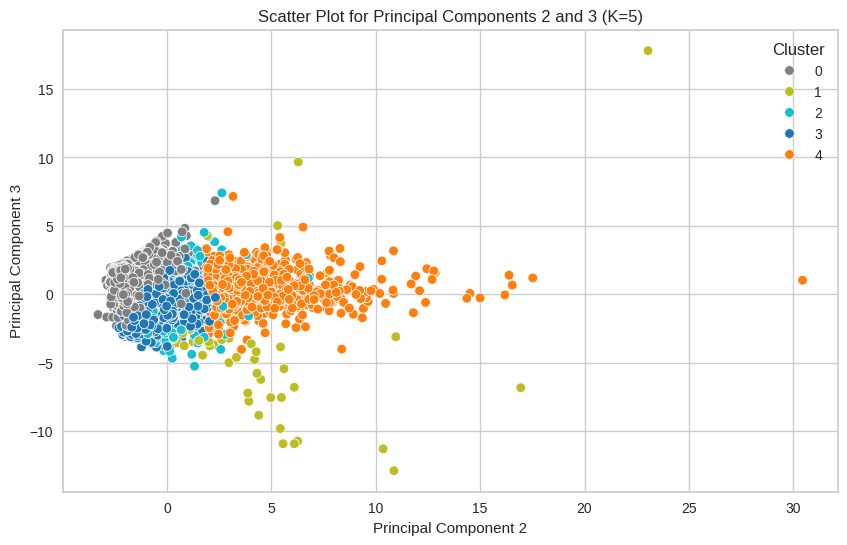

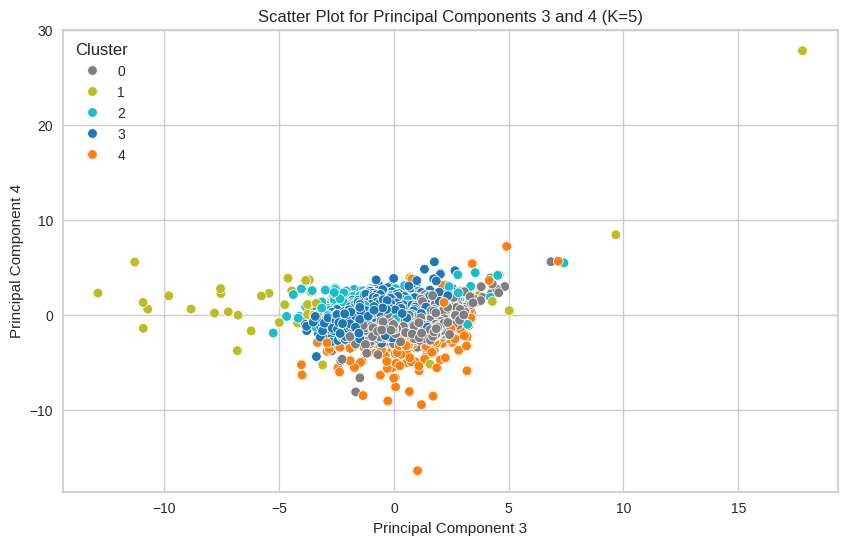

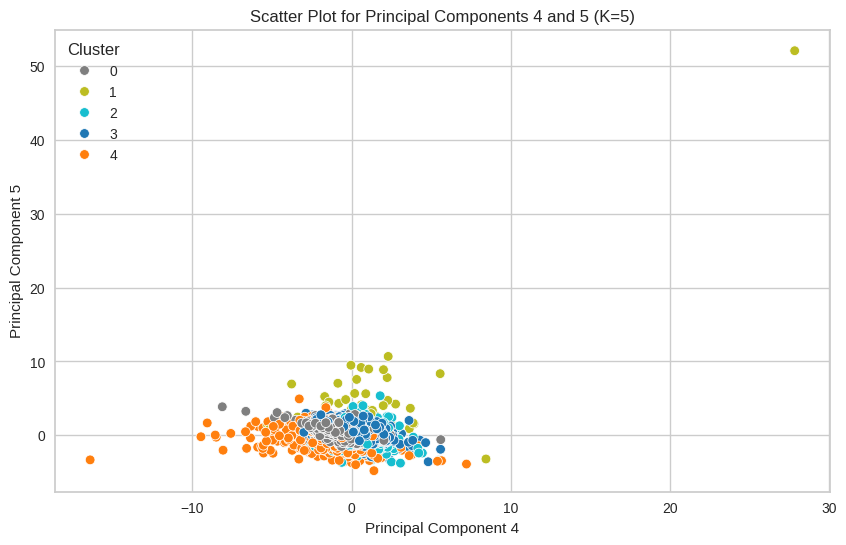

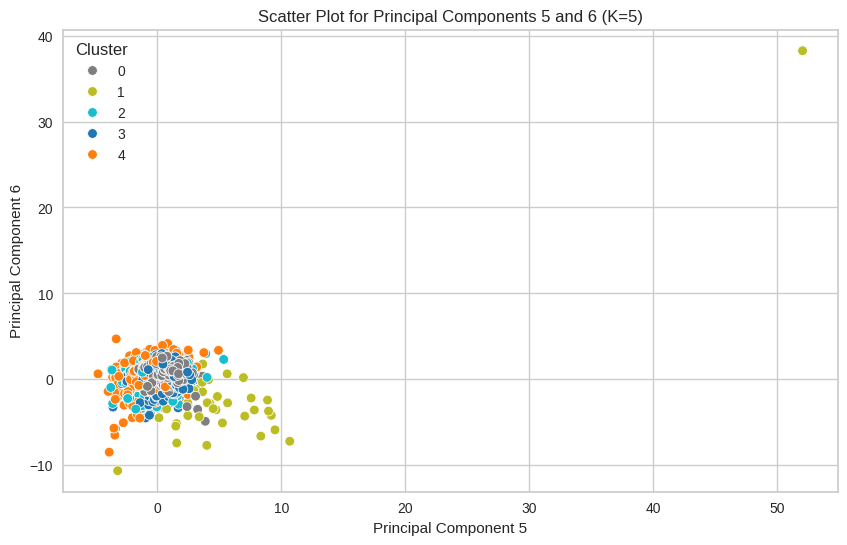

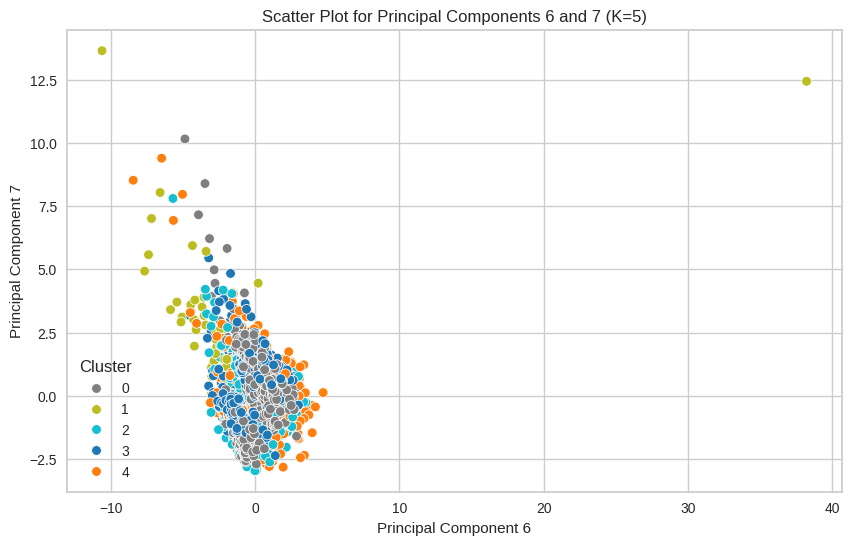

In [ ]:
# Function to apply KMeans clustering and visualize the results
def apply_kmeans_and_visualize(pca_data, n_clusters, palette):
    # Applying KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, init='k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(pca_data)

    # Creating a DataFrame for PCA data and cluster labels
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
    pca_df['Cluster'] = cluster_labels

    # Visualizing the scatter plots for principal component pairs
    for i in range(min(6, pca_data.shape[1] - 1)):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=pca_df[f'PC{i+1}'], y=pca_df[f'PC{i+2}'], hue=pca_df['Cluster'], palette=palette)
        plt.title(f'Scatter Plot for Principal Components {i+1} and {i+2} (K={n_clusters})')
        plt.xlabel(f'Principal Component {i+1}')
        plt.ylabel(f'Principal Component {i+2}')
        plt.legend(title='Cluster')
        plt.show()

# Applying KMeans clustering and visualizing for 3, 4, and 5 clusters
apply_kmeans_and_visualize(pca_data_7, n_clusters=3, palette=['#1f77b4', '#ff7f0e', '#2ca02c'])  # Blue, Orange, Green
apply_kmeans_and_visualize(pca_data_7, n_clusters=4, palette=['#d62728', '#9467bd', '#8c564b', '#e377c2'])  # Red, Purple, Brown, Pink
apply_kmeans_and_visualize(pca_data_7, n_clusters=5, palette=['#7f7f7f', '#bcbd22', '#17becf', '#1f77b4', '#ff7f0e'])  # Gray, Olive, Cyan, Blue, Orange


In [ ]:
# Display summary of segment distributions for each clustering scenario
for n_clusters in range(3, 7):
    try:
        distribution = compute_segment_distribution(dataset, n_clusters)
        print(f'Segment Distribution for {n_clusters} clusters:')
        print(distribution)
        print()
    except KeyError as e:
        print(f"Error: {e} - Check if the cluster column 'cluster_{n_clusters}' exists.")


Segment Distribution for 3 clusters:
cluster_3
0    0.616158
1    0.296234
2    0.087608
Name: proportion, dtype: float64

Segment Distribution for 4 clusters:
cluster_4
0    0.446419
1    0.394011
2    0.032853
3    0.126718
Name: proportion, dtype: float64

Segment Distribution for 5 clusters:
cluster_5
0    0.307409
1    0.009163
2    0.169404
3    0.397810
4    0.116214
Name: proportion, dtype: float64

Segment Distribution for 6 clusters:
cluster_6
0    0.196000
1    0.141804
2    0.008716
3    0.333222
4    0.088837
5    0.231423
Name: proportion, dtype: float64



In [ ]:
#Profiling
# Step 1a: Get the total size of each cluster
for n_clusters in range(3, 7):
    print(f'Total size of cluster {n_clusters}:', dataset[f'cluster_{n_clusters}'].size)

# Step 1b: Get the break up of the values in each segment
for n_clusters in range(3, 7):
    print(f'Value counts for cluster {n_clusters}:\n', dataset[f'cluster_{n_clusters}'].value_counts().sort_index())


Total size of cluster 3: 8949
Total size of cluster 4: 8949
Total size of cluster 5: 8949
Total size of cluster 6: 8949
Value counts for cluster 3:
 cluster_3
0    5514
1    2651
2     784
Name: count, dtype: int64
Value counts for cluster 4:
 cluster_4
0    3995
1    3526
2     294
3    1134
Name: count, dtype: int64
Value counts for cluster 5:
 cluster_5
0    2751
1      82
2    1516
3    3560
4    1040
Name: count, dtype: int64
Value counts for cluster 6:
 cluster_6
0    1754
1    1269
2      78
3    2982
4     795
5    2071
Name: count, dtype: int64


In [ ]:
# Combine the size for each cluster K value into one single array
sizes = pd.concat([
    pd.Series(dataset['cluster_3'].size),
    pd.Series.sort_index(dataset['cluster_3'].value_counts()),
    pd.Series.sort_index(dataset['cluster_4'].value_counts()),
    pd.Series.sort_index(dataset['cluster_5'].value_counts()),
    pd.Series.sort_index(dataset['cluster_6'].value_counts())
])

print("Sizes of each segment for clusters 3 to 6:\n", sizes)


Sizes of each segment for clusters 3 to 6:
 0    8949
0    5514
1    2651
2     784
0    3995
1    3526
2     294
3    1134
0    2751
1      82
2    1516
3    3560
4    1040
0    1754
1    1269
2      78
3    2982
4     795
5    2071
dtype: int64


In [ ]:
# Segment Size
seg_size = pd.DataFrame(sizes, columns=['Seg_size'])

# Segment Distribution Percentage-wise
seg_pct = pd.DataFrame(sizes / dataset['cluster_3'].size, columns=['Seg_Pct'])

# Taking Transpose of Segment Percentage
seg_pct_transposed = seg_pct.T

# Concatenating the Segment Size and Segment Percentage
seg_combined = pd.concat([seg_size.T, seg_pct_transposed], axis=0)

# Displaying the concatenated Segment Size and Segment Percentage
print("Concatenated Segment Size and Segment Percentage:\n", seg_combined)


Concatenated Segment Size and Segment Percentage:
                0            0            1           2            0  \
Seg_size  8949.0  5514.000000  2651.000000  784.000000  3995.000000   
Seg_Pct      1.0     0.616158     0.296234    0.087608     0.446419   

                    1           2            3            0          1  \
Seg_size  3526.000000  294.000000  1134.000000  2751.000000  82.000000   
Seg_Pct      0.394011    0.032853     0.126718     0.307409   0.009163   

                    2           3            4         0            1  \
Seg_size  1516.000000  3560.00000  1040.000000  1754.000  1269.000000   
Seg_Pct      0.169404     0.39781     0.116214     0.196     0.141804   

                  2            3           4            5  
Seg_size  78.000000  2982.000000  795.000000  2071.000000  
Seg_Pct    0.008716     0.333222    0.088837     0.231423  


In [ ]:
# Exclude non-numeric columns
numeric_columns = dataset.select_dtypes(include=[np.number]).columns

# Overall each variable's average
overall_avg = dataset[numeric_columns].apply(np.mean).T
print("Overall Averages:\n", overall_avg)

# Grouping-by over each cluster to find the Segment-wise average for each variable
segment_avgs = {}
for n_clusters in range(3, 7):
    segment_avgs[f'cluster_{n_clusters}'] = dataset[numeric_columns].groupby(f'cluster_{n_clusters}').apply(np.mean).T

# Displaying Segment-wise Averages
for key, value in segment_avgs.items():
    print(f"Segment-wise Averages for {key}:\n", value)


Overall Averages:
 balance                             1564.647593
balance_frequency                      0.877350
purchases                           1003.316936
oneoff_purchases                     592.503572
installments_purchases               411.113579
cash_advance                         978.959616
purchases_frequency                    0.490405
oneoff_purchases_frequency             0.202480
purchases_installments_frequency       0.364478
cash_advance_frequency                 0.135141
cash_advance_trx                       3.249078
purchases_trx                         14.711476
credit_limit                        4494.449450
payments                            1733.336511
minimum_payments                     864.304943
prc_full_payment                       0.153732
tenure                                11.517935
Monthly_Avg_Purchase                  86.184802
Credit_Utilization_Ratio               0.512385
Limit_Usage                            0.388926
Pay_to_MinimumPay    

In [ ]:
# Dropping the 'Purchase_Type' column for mean calculation
numeric_columns = dataset.select_dtypes(include=[np.number]).columns

# Calculate segment-wise averages for each number of clusters for numeric columns
segment_3_avg = dataset.groupby('cluster_3')[numeric_columns].apply(np.mean).T
segment_4_avg = dataset.groupby('cluster_4')[numeric_columns].apply(np.mean).T
segment_5_avg = dataset.groupby('cluster_5')[numeric_columns].apply(np.mean).T
segment_6_avg = dataset.groupby('cluster_6')[numeric_columns].apply(np.mean).T

print("Segment-wise averages for 3 clusters:\n", segment_3_avg)
print("Segment-wise averages for 4 clusters:\n", segment_4_avg)
print("Segment-wise averages for 5 clusters:\n", segment_5_avg)
print("Segment-wise averages for 6 clusters:\n", segment_6_avg)


Segment-wise averages for 3 clusters:
 cluster_3
0     337.566917
1     528.517831
2    1047.391253
dtype: float64
Segment-wise averages for 4 clusters:
 cluster_4
0     327.700900
1     410.774487
2    1508.972042
3     777.726014
dtype: float64
Segment-wise averages for 5 clusters:
 cluster_5
0     306.611424
1    2421.413868
2     664.391106
3     339.627930
4     793.034783
dtype: float64
Segment-wise averages for 6 clusters:
 cluster_6
0     366.265904
1     708.824201
2    2475.869556
3     307.822683
4     857.375523
5     361.313866
dtype: float64


In [ ]:
# Selecting only the numeric columns
numeric_columns = dataset.select_dtypes(include=[np.number]).columns

# Grouping by cluster_3 to find the segment-wise average for each variable
cluster_3_avg = dataset.groupby('cluster_3')[numeric_columns].mean().T

# Display the result
print(cluster_3_avg)


cluster_3                                   0            1            2
balance                            940.706208  2557.266809  2596.508886
balance_frequency                    0.849637     0.914265     0.947438
purchases                          779.586253   399.751403  4617.734298
oneoff_purchases                   416.819920   238.968506  3023.550918
installments_purchases             362.951536   161.375688  1594.303189
cash_advance                       446.309460  2163.929516   718.344507
purchases_frequency                  0.554109     0.254941     0.838560
oneoff_purchases_frequency           0.195357     0.104123     0.585162
purchases_installments_frequency     0.410113     0.176156     0.680308
cash_advance_frequency               0.077126     0.268804     0.091202
cash_advance_trx                     1.710374     6.715579     2.349490
purchases_trx                       12.782191     6.179932    57.128827
credit_limit                      3860.934252  4804.955363  7900

In [ ]:
# Ensure we are only working with numeric columns
numeric_cols = dataset.select_dtypes(include=[np.number]).columns.tolist()

# Apply the lambda function to calculate means only for numeric columns
Profiling_output = pd.concat([
    dataset[numeric_cols].apply(lambda x: x.mean()).T,
    dataset.groupby('cluster_3')[numeric_cols].apply(lambda x: x.mean()).T,
    dataset.groupby('cluster_4')[numeric_cols].apply(lambda x: x.mean()).T,
    dataset.groupby('cluster_5')[numeric_cols].apply(lambda x: x.mean()).T,
    dataset.groupby('cluster_6')[numeric_cols].apply(lambda x: x.mean()).T
], axis=1)

# Assign column names
#Profiling_output.columns = ['Overall'] + [
 #   f'KM{n_clusters}_{i+1}'
  #  for n_clusters in range(3, 7)
   # for i in range(n_clusters)
#]

Profiling_output
# Display the profiling output
#import ace_tools as tools; tools.display_dataframe_to_user(name="Profiling Output", dataframe=Profiling_output)


,0,0,1,2,0,1,2,3,0,1,2,3,4,0,1,2,3,4,5
balance,1564.647593,940.706208,2557.266809,2596.508886,1213.744024,1105.790869,3466.842531,3734.438821,790.639168,4306.520490,1813.585856,1351.286914,3763.337216,1207.389262,1942.704363,4448.844932,813.703076,4023.481854,1664.335178
balance_frequency,0.877350,0.849637,0.914265,0.947438,0.836091,0.901349,0.961287,0.926319,0.843169,0.952217,0.950602,0.857778,0.922078,0.843304,0.951465,0.949767,0.847175,0.928732,0.881768
purchases,1003.316936,779.586253,399.751403,4617.734298,490.926003,1154.441931,7733.935850,593.557751,681.891574,13991.817927,2394.986128,481.398121,587.398260,761.295410,2631.198195,14323.146282,695.818467,655.761736,285.327832
oneoff_purchases,592.503572,416.819920,238.968506,3023.550918,314.473252,599.234606,5219.672687,351.418730,225.455300,9510.021829,1555.128199,335.157565,338.009490,689.952908,1647.087730,9744.511923,223.491824,375.500943,133.720396
installments_purchases,411.113579,362.951536,161.375688,1594.303189,176.601972,555.442087,2514.582653,243.169700,456.727357,4481.796098,839.952210,146.401831,250.512606,71.402902,984.184484,4578.634359,472.626868,281.730969,151.811540
cash_advance,978.959616,446.309460,2163.929516,718.344507,721.398585,439.040828,651.326755,3650.065458,432.307863,877.128534,460.983732,794.217853,3820.422345,505.391402,489.074485,886.091446,422.605690,4258.890073,1225.724121
purchases_frequency,0.490405,0.554109,0.254941,0.838560,0.297707,0.717954,0.858008,0.366435,0.638973,0.850610,0.798952,0.271280,0.369331,0.363945,0.812954,0.842949,0.644464,0.410533,0.195424
oneoff_purchases_frequency,0.202480,0.195357,0.104123,0.585162,0.128045,0.266002,0.644679,0.152558,0.098085,0.675517,0.545066,0.142775,0.146320,0.322579,0.526075,0.682382,0.096981,0.163642,0.051223
purchases_installments_frequency,0.364478,0.410113,0.176156,0.680308,0.191107,0.566940,0.698311,0.259177,0.561182,0.703769,0.552728,0.153499,0.265193,0.069579,0.632738,0.694988,0.570786,0.296200,0.166565
cash_advance_frequency,0.135141,0.077126,0.268804,0.091202,0.125979,0.076385,0.074498,0.365831,0.072310,0.072561,0.076495,0.141258,0.370821,0.089976,0.080807,0.071581,0.071832,0.392643,0.201388


In [ ]:
# Combine the segment size, segment distribution, the overall averages, and the individual segment-wise averages
Profiling_output_final = pd.concat([seg_size.T, seg_pct.T, Profiling_output], axis=0)

# Define the expected columns
expected_columns = ['Overall', 'KM3_1', 'KM3_2', 'KM3_3',
                    'KM4_1', 'KM4_2', 'KM4_3', 'KM4_4',
                    'KM5_1', 'KM5_2', 'KM5_3', 'KM5_4', 'KM5_5',
                    'KM6_1', 'KM6_2', 'KM6_3', 'KM6_4', 'KM6_5','KM6_6']

# Assign the column names to Profiling_output_final
Profiling_output_final.columns = expected_columns[:Profiling_output_final.shape[1]]

# Displaying the final profiling output
print("Profiling Output Final:")
print(Profiling_output_final)


Profiling Output Final:
                                      Overall        KM3_1        KM3_2  \
Seg_size                          8949.000000  5514.000000  2651.000000   
Seg_Pct                              1.000000     0.616158     0.296234   
balance                           1564.647593   940.706208  2557.266809   
balance_frequency                    0.877350     0.849637     0.914265   
purchases                         1003.316936   779.586253   399.751403   
oneoff_purchases                   592.503572   416.819920   238.968506   
installments_purchases             411.113579   362.951536   161.375688   
cash_advance                       978.959616   446.309460  2163.929516   
purchases_frequency                  0.490405     0.554109     0.254941   
oneoff_purchases_frequency           0.202480     0.195357     0.104123   
purchases_installments_frequency     0.364478     0.410113     0.176156   
cash_advance_frequency               0.135141     0.077126     0.268804   
c

In [ ]:
# Exporting the output
Profiling_output_final.to_csv('Profiling_output_final.csv', index=False)

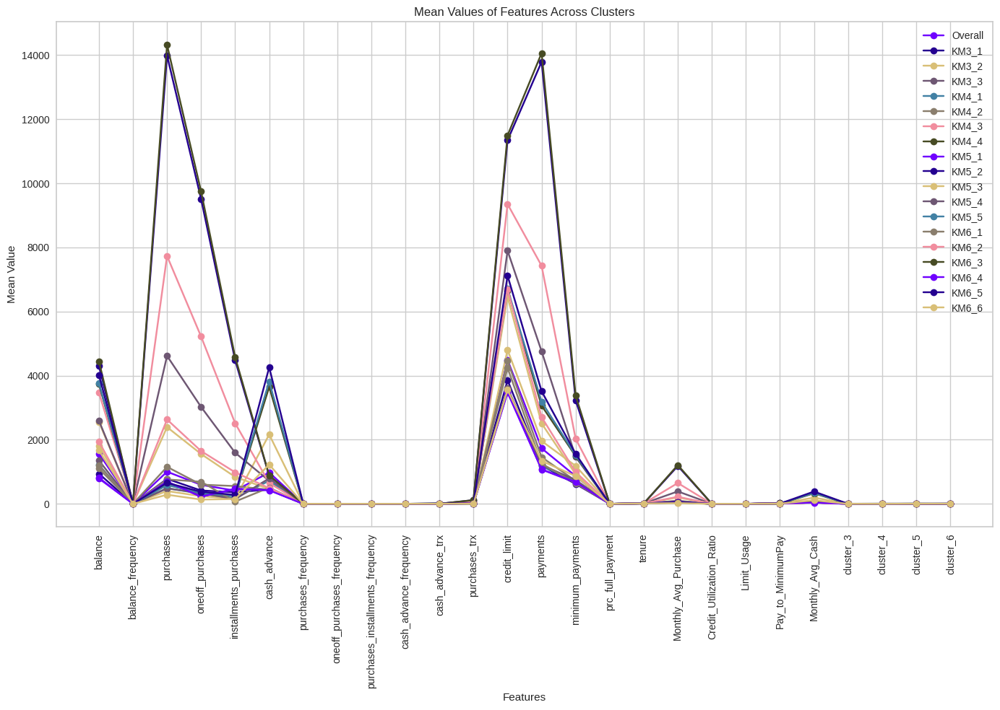

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Mount Google Drive
#drive.mount('/content/drive')

# Load the profiling data
profiling_data = pd.read_csv('./Profiling_output_final.csv')

# Extract the mean values for each feature and cluster
feature_means = profiling_data.iloc[2:, 1:].astype(float)
features = profiling_data.iloc[2:, 0]

# Plot the feature means
plt.figure(figsize=(14, 10))
for col in feature_means.columns:
    plt.plot(features, feature_means[col], marker='o', label=col)

plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Mean Value')
plt.title('Mean Values of Features Across Clusters')
plt.legend()
plt.tight_layout()
plt.show()


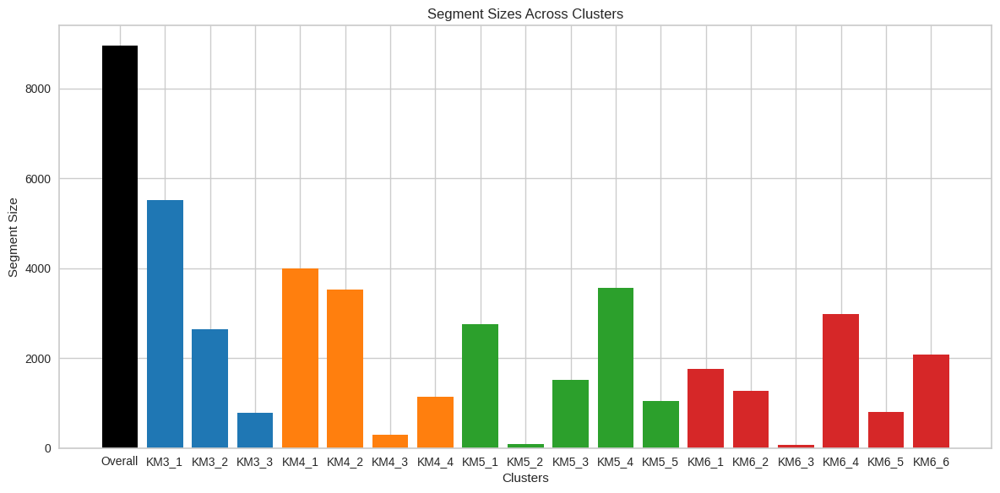

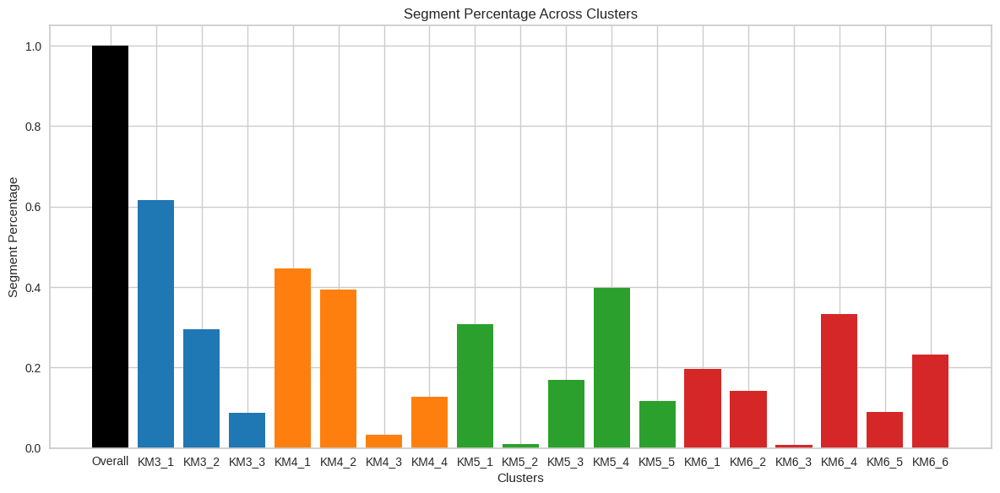

In [ ]:
# Extract the segmentation sizes and percentages
seg_size = profiling_data.iloc[0, 1:].astype(float)
seg_pct = profiling_data.iloc[1, 1:].astype(float)

# Define a consistent color palette for clusters
colors = ['#000000',
          '#1f77b4', '#1f77b4', '#1f77b4',
          '#ff7f0e', '#ff7f0e', '#ff7f0e', '#ff7f0e',
          '#2ca02c', '#2ca02c', '#2ca02c', '#2ca02c', '#2ca02c',
          '#d62728', '#d62728', '#d62728', '#d62728', '#d62728','#d62728']

# Plot segmentation sizes
plt.figure(figsize=(12, 6))
plt.bar(seg_size.index, seg_size.values, color=colors)
plt.xlabel('Clusters')
plt.ylabel('Segment Size')
plt.title('Segment Sizes Across Clusters')
plt.tight_layout()
plt.show()

# Plot segmentation percentages
plt.figure(figsize=(12, 6))
plt.bar(seg_pct.index, seg_pct.values, color=colors)
plt.xlabel('Clusters')
plt.ylabel('Segment Percentage')
plt.title('Segment Percentage Across Clusters')
plt.tight_layout()
plt.show()


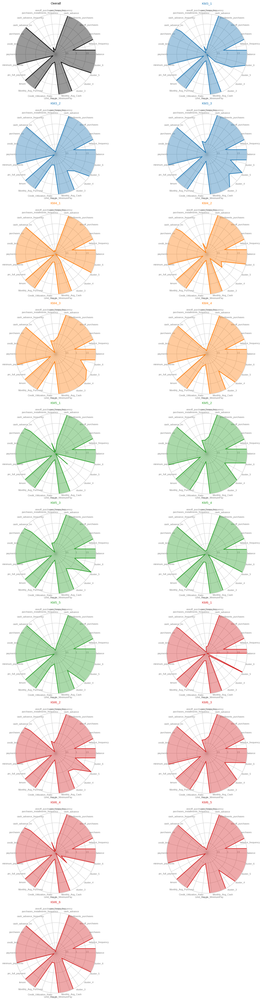

In [ ]:
from math import pi

def make_spider(row, title, color, total_rows):
    # Number of variables
    categories = list(feature_means.index)
    N = len(categories)

    # What will be the angle of each axis in the plot?
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    # Initialise the spider plot
    ax = plt.subplot((total_rows + 1) // 2, 2, row + 1, polar=True)

    # Draw one axe per variable and add labels
    plt.xticks(angles[:-1], categories, color='grey', size=8)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([0.5, 1, 1.5], ["0.5", "1", "1.5"], color="grey", size=7)
    plt.ylim(0, 2)

    # Ind1
    values = feature_means.iloc[:, row].values.flatten().tolist()
    values += values[:1]
    ax.plot(angles, values, color=color, linewidth=2, linestyle='solid')
    ax.fill(angles, values, color=color, alpha=0.4)

    # Add a title
    plt.title(title, size=11, color=color, y=1.1)

# Load the profiling data
profiling_data = pd.read_csv('./Profiling_output_final.csv', index_col=0)

# Extracting feature means for radar charts
feature_means = profiling_data.iloc[2:]

# Initialise the figure
total_rows = len(feature_means.columns)
plt.figure(figsize=(15, total_rows * 2.5))

# Define a consistent color palette for clusters
color_palette = ['#000000'] + ['#1f77b4'] * 3 + ['#ff7f0e'] * 4 + ['#2ca02c'] * 5 + ['#d62728'] * 6

# Loop to plot each cluster
for row in range(total_rows):
    make_spider(row=row, title=feature_means.columns[row], color=color_palette[row], total_rows=total_rows)

plt.tight_layout()
plt.show()


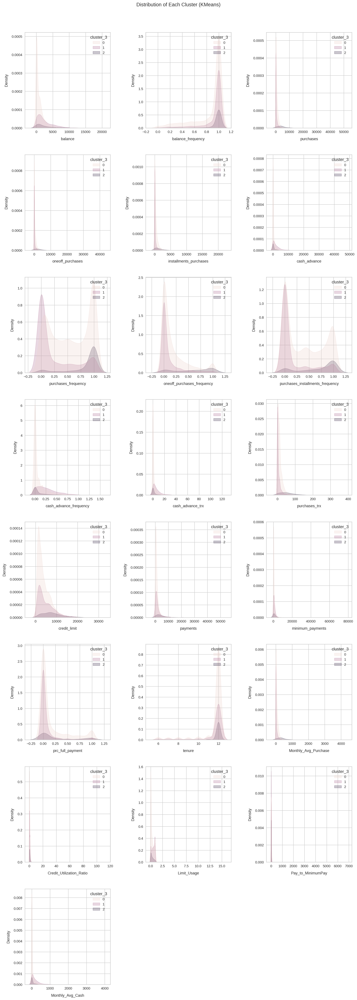

In [ ]:
# Ensure all columns except the cluster column are numeric
numeric_cols = dataset.select_dtypes(include=['float64', 'int64']).columns
numeric_dataset = dataset[numeric_cols]

# Add the cluster_3 column back to the numeric dataset
numeric_dataset['cluster_3'] = dataset['cluster_3']

# Check KDE of clusters
def check_kde(dataset, name):
    num_cols = len(dataset.columns[:-1])
    num_rows = (num_cols // 3) + 1 if num_cols % 3 != 0 else num_cols // 3
    plt.figure(figsize=(15, num_rows * 5), dpi=200)
    for i, col in enumerate(dataset.columns[:-1], 1):
        plt.subplot(num_rows, 3, i)
        sns.kdeplot(data=dataset, x=col, hue='cluster_3', fill=True)
        plt.ylabel("Density", labelpad=10)
        plt.xlabel(col, labelpad=10)
    plt.suptitle(f"Distribution of Each Cluster ({name})", y=1)
    plt.tight_layout(pad=3.0)
    plt.show()

# Call the function with the numeric dataset
check_kde(numeric_dataset, 'KMeans')

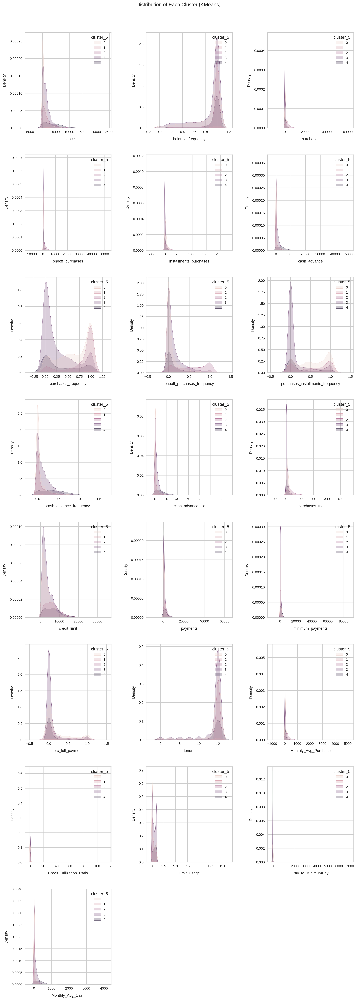

In [ ]:
# Ensure all columns except the cluster column are numeric
numeric_cols = dataset.select_dtypes(include=['float64', 'int64']).columns
numeric_dataset = dataset[numeric_cols]

# Add the cluster_3 column back to the numeric dataset
numeric_dataset['cluster_5'] = dataset['cluster_5']

# Check KDE of clusters
def check_kde(dataset, name):
    num_cols = len(dataset.columns[:-1])
    num_rows = (num_cols // 3) + 1 if num_cols % 3 != 0 else num_cols // 3
    plt.figure(figsize=(15, num_rows * 5), dpi=200)
    for i, col in enumerate(dataset.columns[:-1], 1):
        plt.subplot(num_rows, 3, i)
        sns.kdeplot(data=dataset, x=col, hue='cluster_5', fill=True)
        plt.ylabel("Density", labelpad=10)
        plt.xlabel(col, labelpad=10)
    plt.suptitle(f"Distribution of Each Cluster ({name})", y=1)
    plt.tight_layout(pad=3.0)
    plt.show()

# Call the function with the numeric dataset
check_kde(numeric_dataset, 'KMeans')

In [ ]:
# Plotting Pair Plot
sns.pairplot(dataset)
plt.show()

SyntaxError: invalid syntax (<ipython-input-60-f4c6fa95df70>, line 1)

In [ ]:
# Plotting Pair Plot
sns.pairplot(profiling_output)
plt.show()

In [ ]:
# Plotting Pair Plot
sns.pairplot(profiling_output_final)
plt.show()